In [1]:
import os
import sys
from pathlib import Path

import anndata as ad
import cv2 as cv
import h5py
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
from joblib import Parallel, delayed
from matplotlib.pyplot import rc_context
from skimage import exposure, io
from skimage.util import img_as_ubyte
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from tqdm.notebook import tqdm, trange

sc.settings.verbosity = 3

In [2]:
p_dir = (Path().cwd().parents[0]).absolute()
data_dir = p_dir / "data"

In [3]:
%load_ext autoreload
%autoreload 2

module_path = str(p_dir / "src")

if module_path not in sys.path:
    sys.path.append(module_path)

import scanorama
import utils as my_utils

In [4]:
experiment = "tonsil"
cores = ["DonorA", "DonorE"]
datasets = [core + f"_{i}" for core in cores for i in range(1, 7)]

# Load data

In [5]:
def read_props(dataset):
    df_morph = pd.read_csv(data_dir / "props" / f"morphology_IMC_{dataset}.csv")
    df_intensity_IMC = pd.read_csv(data_dir / "props" / f"intensity_IMC_{dataset}.csv")
    df_intensity_TS = pd.read_csv(data_dir / "props" / f"intensity_TS_{dataset}.csv")

    return df_morph, df_intensity_IMC, df_intensity_TS

In [6]:
adatas = []
for dataset in datasets:
    try:
        df_morph, df_intensity_IMC, df_intensity_TS = read_props(
            "_".join([experiment, dataset])
        )
    except:
        continue
    df_intensity_TS.drop(['Rest', 'Total'], axis=1, inplace=True)
    # df_intensity_TS.iloc[:, 1:] = df_intensity_TS.iloc[:, 1:].multiply(
    #     df_morph["area"], axis=0
    # )
    pseudo_count=1
    data_all = df_intensity_TS.iloc[:, 1:].values
    data_all_norm = (data_all+pseudo_count)/(np.percentile(data_all,50,axis=1,keepdims=True)+pseudo_count)
    data_all_norm = MinMaxScaler().fit_transform(data_all_norm)
    df_intensity_TS.iloc[:, 1:] = data_all_norm
    
    # df = df_intensity_IMC.merge(df_intensity_TS, on="Id")
    df = df_intensity_IMC
    df.set_index("Id", inplace=True)

    adata = sc.AnnData(df.values, dtype=df.values.dtype)
    adata.var_names = df.columns.tolist()
    adata.obs["Cell"] = df.index.tolist()
    adata.obs["Dataset"] = dataset.split("_")[0]
    adata.obs["Core"] = dataset
    adata.obsm["spatial"] = df_morph[["centroid-0", "centroid-1"]].to_numpy()
    adatas.append(adata)

adata = ad.concat(adatas, join="inner")

C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [7]:
IMC_markers = df_intensity_IMC.columns[1:]
SIMS_masses = df_intensity_TS.columns[1:]

In [8]:
IMC_markers

Index(['C-Myc', 'CD11b', 'CD11c', 'CD138', 'CD20', 'CD21', 'CD27', 'CD3',
       'CD38', 'CD4', 'CD8', 'CD83', 'CD86', 'COL1', 'CXCR4', 'CXCR5', 'DNA1',
       'DNA2', 'EZH2', 'FoxP3', 'H3K27me3', 'ICOS1', 'Ki67', 'PD1',
       'Vimentin'],
      dtype='object')

In [9]:
IMC_markers = IMC_markers.drop(["Vimentin", "COL1", "CD138", "FoxP3", "CD86", "CD83", "CXCR4", 'CD8',"DNA1", "DNA2", "CD11b", "CD11c",'C-Myc'])

In [10]:
# IMC_markers = IMC_markers.drop([ "CD138", "FoxP3", "CD86", "CD83", "CXCR4", 'CD8',"DNA1", "DNA2", "CD11b", "CD11c"])

In [11]:
IMC_markers

Index(['CD20', 'CD21', 'CD27', 'CD3', 'CD38', 'CD4', 'CXCR5', 'EZH2',
       'H3K27me3', 'ICOS1', 'Ki67', 'PD1'],
      dtype='object')

## Export FCS files

In [12]:
# # Export FCS
# import flowkit as fk
# from sklearn import preprocessing
# from sklearn.preprocessing import MinMaxScaler

# centroids = adata.obsm["spatial"]

# df = pd.DataFrame(adata.X, columns=adata.var_names)
# df['Cell'] = adata.obs['Cell'].tolist()
# df['Core'] = adata.obs['Core'].tolist()

# # Reset to get all samples index
# df_2labels = df.reset_index()

# # Normalize all togther
# scaler = MinMaxScaler()
# # Normalize per Tissue
# for donor in df_2labels['Core'].unique():
#     df_subset = df_2labels[df_2labels.Core == donor]
#     data = df_subset.iloc[:, 1:-2]
#     data_scaled = scaler.fit_transform(data)*(2**18)
#     df_2labels.loc[df_2labels.Core == donor, 1:-2] = data_scaled


# # Add spatial info
# df_2labels['X'] = centroids[:,1]
# df_2labels['Y'] = centroids[:,0]


In [13]:
# for donor in df_2labels['Core'].unique():
#     df_subset = df_2labels[df_2labels.Core == donor]
#     df_subset.drop('Core', inplace=True, axis=1)
#     sample = fk.Sample(df_subset, cache_original_events=True)
#     sample.original_filename = donor
    
#     df_channels = sample.channels
#     df_channels.pnr = np.max(df_subset).tolist()
#     sample.channels = df_channels
    
#     sample.export(f'{donor}.fcs', source='orig')

In [14]:
# le = preprocessing.LabelEncoder()
# df_2labels['Core'] = le.fit_transform(df_2labels['Core'])

# sample = fk.Sample(df_2labels, cache_original_events=True)

# df_channels = sample.channels
# df_channels.pnr = np.max(df_2labels).tolist()
# sample.channels = df_channels

In [15]:
# sample.export('tonsil.fcs', source='orig')


In [16]:
# le_name_mapping = dict(zip(le.classes_, le.transform(le.classes_)))

In [17]:
# print(le_name_mapping)


# IMC cell phenotype

## Data ingegration

In [18]:
adata_IMC = adata[:, IMC_markers]
# sc.pp.log1p(adata_IMC)
# sc.pp.scale(adata_IMC, max_value=4)

In [19]:
alldata = {}

for batch in adata_IMC.obs["Core"].unique():
    adata_subset = adata_IMC[
        adata_IMC.obs["Core"] == batch,
    ]
    sc.pp.log1p(adata_subset)
    sc.pp.scale(adata_subset, max_value=4)
    alldata[batch] = adata_subset

# convert to list of AnnData objects
adatas = list(alldata.values())

# run scanorama.integrate
adatas_cor = scanorama.correct_scanpy(adatas, return_dimred=True, return_dense=True, dimred=10)

# make into one matrix.
adata_IMC = ad.concat(adatas_cor)

C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\preprocessing\_simple.py:373: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\preprocessing\_simple.py:373: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  view_to_actual(adata)
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\preprocessing\_simple.py:373: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\preprocessing\_simple.py:373: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pa

Found 12 genes among all datasets
[[0.         0.42632097 0.76791647 0.56326079 0.78031496 0.43634225
  0.35736144 0.28181483 0.37845813 0.3041613  0.16367265]
 [0.         0.         0.3146654  0.88743026 0.22362205 0.37312555
  0.24039442 0.24942566 0.18444372 0.26083226 0.1756487 ]
 [0.         0.         0.         0.36260085 0.85511811 0.21214998
  0.43711438 0.25913621 0.31893688 0.2016302  0.12149976]
 [0.         0.         0.         0.         0.46102362 0.54307557
  0.28017681 0.21802426 0.20831889 0.38395538 0.15701929]
 [0.         0.         0.         0.         0.         0.46181102
  0.38320299 0.2503937  0.36102362 0.2968683  0.10708661]
 [0.         0.         0.         0.         0.         0.
  0.26786239 0.76095266 0.68509262 0.68682969 0.5292561 ]
 [0.         0.         0.         0.         0.         0.
  0.         0.7633458  0.8265896  0.40938456 0.45642049]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.87421798 0.559

C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanorama\scanorama.py:237: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = AnnData(datasets[i])
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanorama\scanorama.py:237: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = AnnData(datasets[i])
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanorama\scanorama.py:237: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pa

In [20]:
sc.pp.neighbors(adata_IMC, use_rep="X_scanorama")
sc.tl.umap(adata_IMC)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:26)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


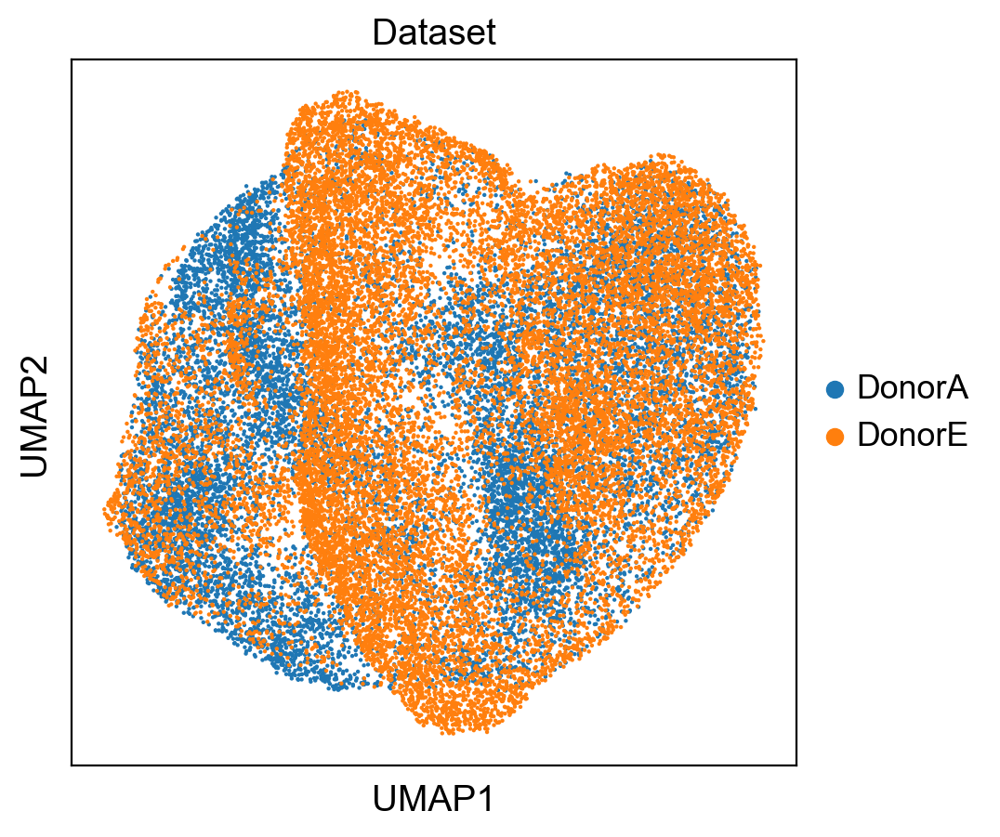

In [21]:
sc.set_figure_params(format="png")

with rc_context({"figure.figsize": (5, 5), "figure.dpi": 100}):
    fig = sc.pl.umap(adata_IMC, color=["Dataset"], size=10)

C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


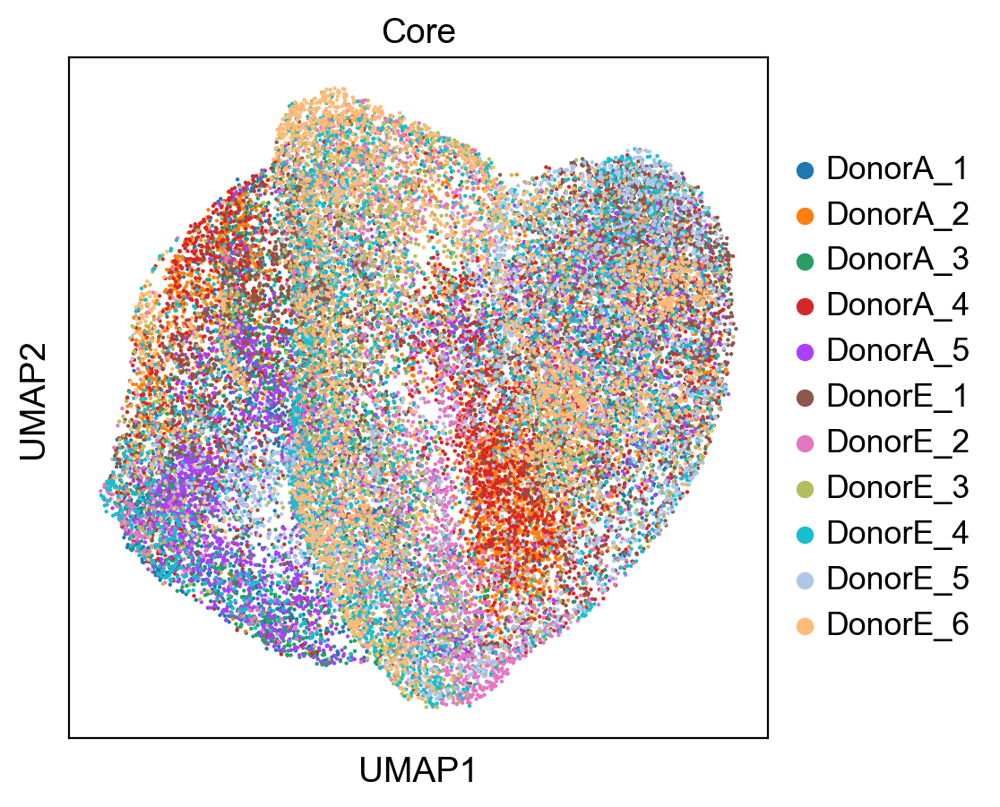

In [22]:
sc.set_figure_params(format="png")

with rc_context({"figure.figsize": (5, 5), "figure.dpi": 100}):
    fig = sc.pl.umap(adata_IMC, color=["Core"], size=10)

## Clustering

In [23]:
sc.pp.neighbors(adata_IMC, metric='cosine', use_rep="X_scanorama", random_state=0)
sc.tl.leiden(adata_IMC, resolution=0.5, random_state=0)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:05)


C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


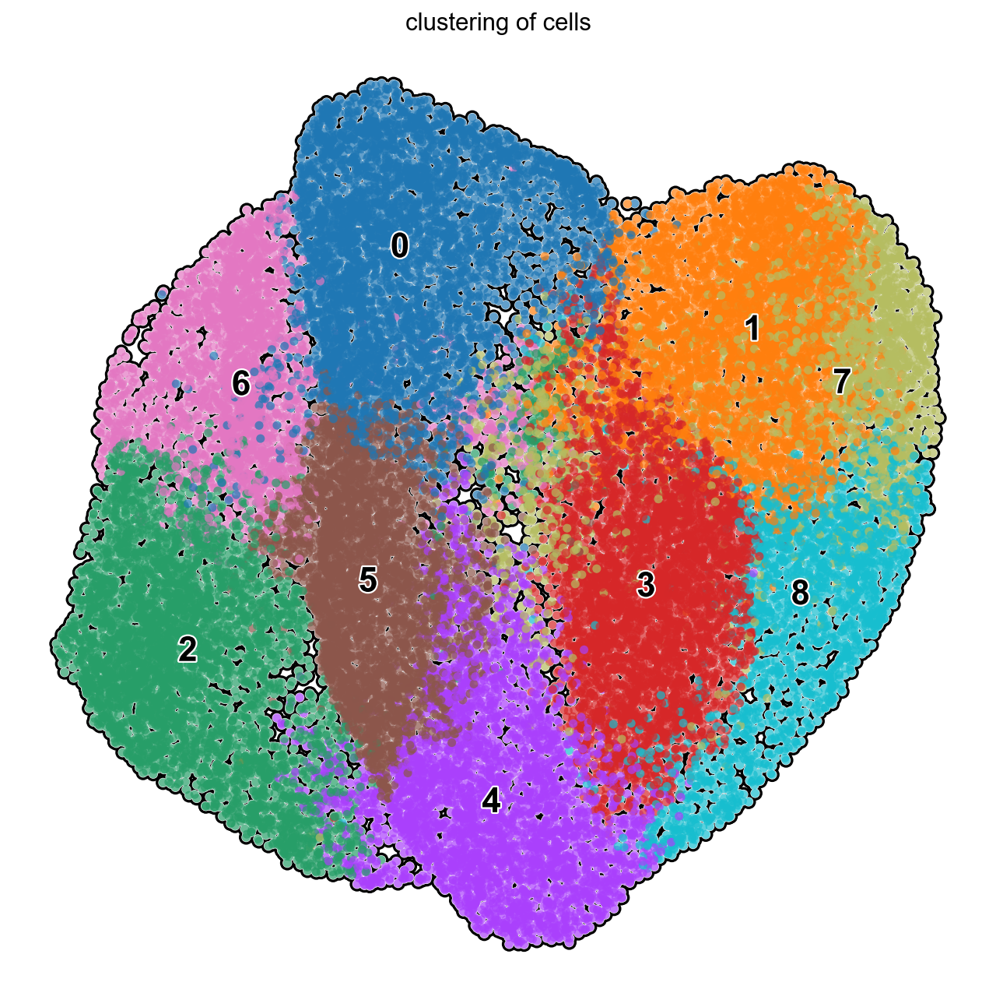

In [24]:
with rc_context({"figure.figsize": (10, 10)}):
    sc.pl.umap(
        adata_IMC,
        color=["leiden"],
        size=100,
        legend_loc="on data",
        add_outline=True,
        legend_fontsize=20,
        legend_fontoutline=2,
        frameon=False,
        title="clustering of cells",
    )

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_leiden']`


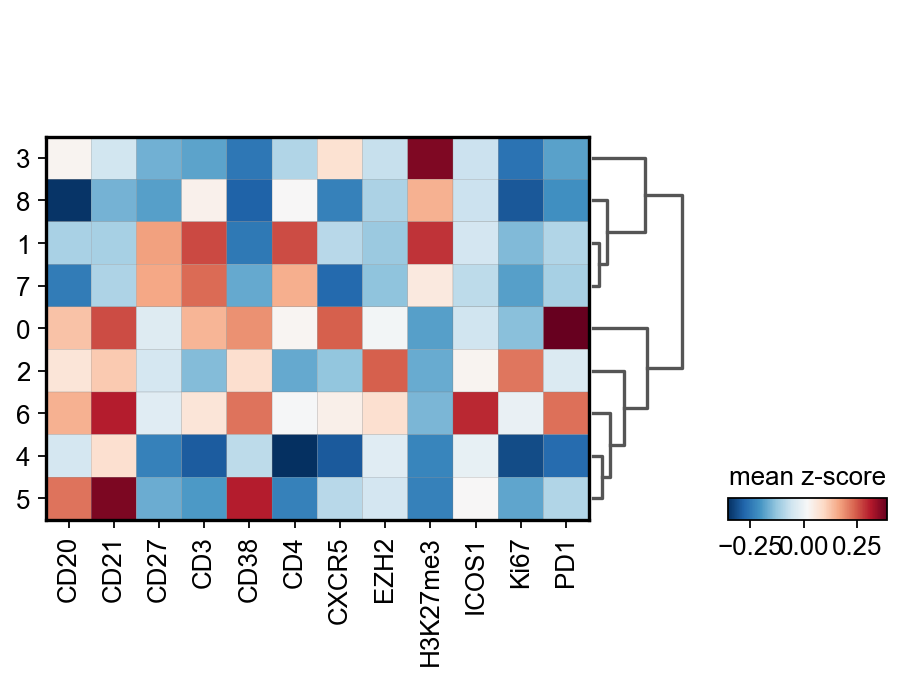

In [25]:
sc.tl.dendrogram(adata_IMC, groupby="leiden")
sns.set_style(rc = {'axes.facecolor':  (1,1,1,0),  'figure.facecolor':  (1,1,1,0)})
# sns.set_context("notebook", font_scale=1.8)
sc.pl.matrixplot(
    adata_IMC,
    adata_IMC.var_names.tolist(),
    "leiden",
    dendrogram=True,
    colorbar_title="mean z-score",
    cmap="RdBu_r",
    swap_axes=False,
    # vmin=-0.25,
    # vmax=0.5
)

C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\plotting\_anndata.py:2414: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  obs_tidy.index.value_counts(sort=False).iteritems()


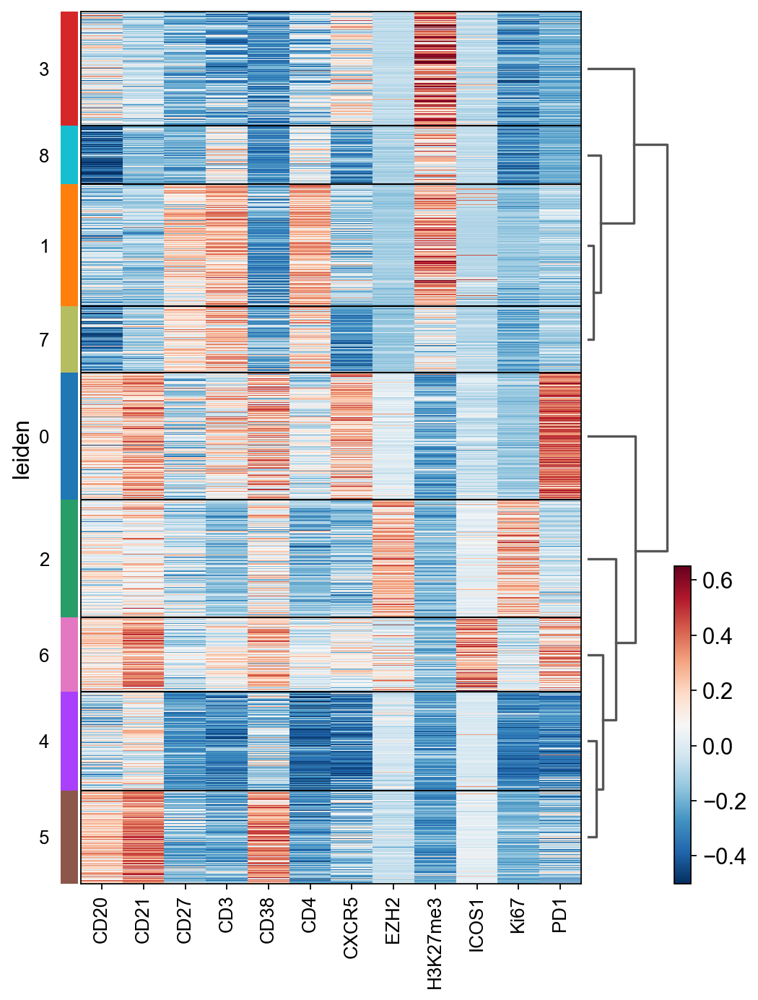

In [26]:
sc.pl.heatmap(
    adata_IMC,
    adata_IMC.var_names.tolist(),
    "leiden",
    dendrogram=True,
    cmap="RdBu_r",
    figsize=(7, 10),
    vmin=-0.5,
    vmax=0.65
)

In [27]:
cluster_label_order = adata_IMC.uns['dendrogram_leiden']['categories_ordered']

In [28]:
import matplotlib 

colors = adata_IMC.uns["leiden_colors"]
labels = adata_IMC.obs.leiden.cat.categories.tolist()

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

colors_rgb_dict = {k:v for k,v in zip(labels, colors_rgb)}

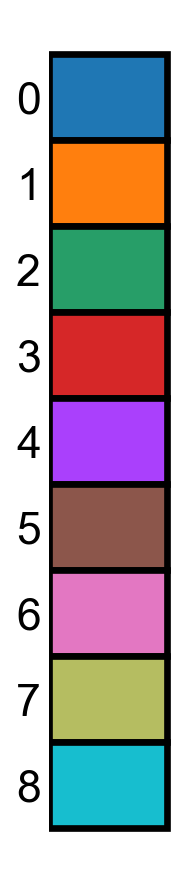

In [29]:
# legend
fig, ax = plt.subplots(figsize=(1,7))
ax.barh(y=range(len(colors_rgb_dict.values())), 
        color=np.array(list(colors_rgb_dict.values()))/255,
        width=1, 
        height=1,
        edgecolor='k',
        linewidth=3,
       )
_ = plt.yticks(range(len(colors_rgb_dict.values())), colors_rgb_dict.keys(), rotation=0, size=20)
_ = plt.xticks([])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.tick_params(axis=u'both', which=u'both',length=0)
# ax.yaxis.tick_right()
ax.invert_yaxis()
ax.grid(False)


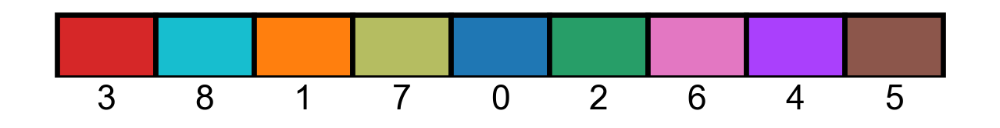

In [30]:
# legend
c=np.array([colors_rgb_dict[i] for i in cluster_label_order])

fig, ax = plt.subplots(figsize=(10,0.7))
ax.bar(x=cluster_label_order, 
        color=c/255,
        width=1, 
        height=1,
        edgecolor='k',
        linewidth=3,
       )
_ = plt.xticks(range(len(colors_rgb_dict.values())), cluster_label_order, rotation=0, size=20)
_ = plt.yticks([])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.tick_params(axis=u'both', which=u'both',length=0)
ax.grid(False)


## Stats

In [31]:
df = pd.DataFrame(adata_IMC.X, columns=adata_IMC.var_names)
df['ROI'] = adata_IMC.obs.Dataset.tolist()
df['Clusters'] = adata_IMC.obs.leiden.tolist()

In [32]:
df_count = (
    df.groupby(['ROI', 'Clusters'])
    .size()
    .div(
        df.groupby(['ROI'])['Clusters'].size()
    )
    .reset_index(name = 'Density')
)

<AxesSubplot: xlabel='Clusters', ylabel='Density'>

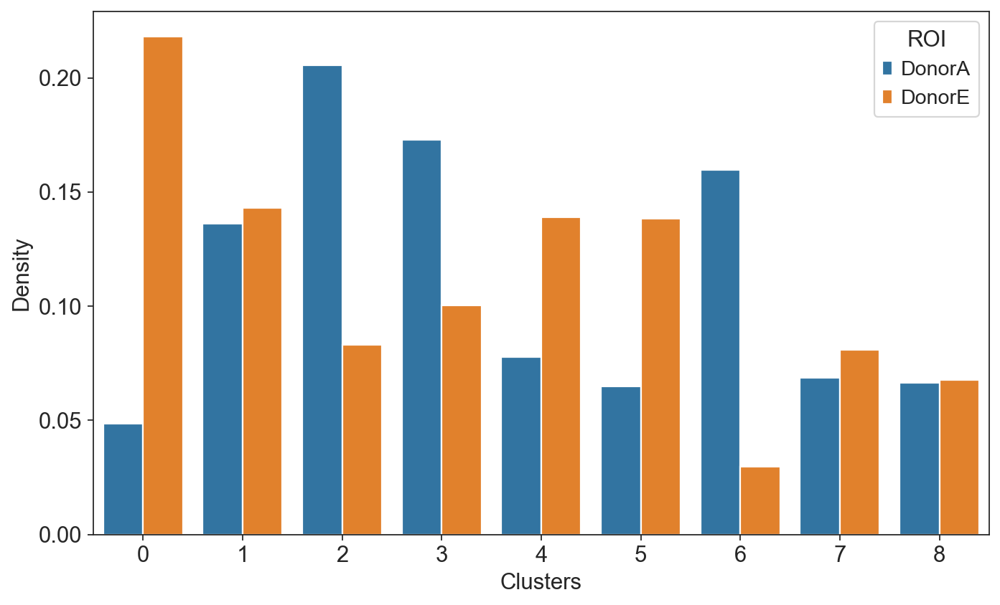

In [33]:
sns.set_style('ticks')
fig, ax = plt.subplots(figsize=(10,6))
sns.barplot(data=df_count, x='Clusters', y='Density', hue='ROI', ax=ax)

## Spatial projection

In [34]:
from typing import List
import matplotlib
import skimage
from skimage import measure


def get_masks(mask_folder, dataset):
    """
    Function to get all mask from mask forlder
    """
    # Read masks
    masks = {}

    for (dirpath, dirnames, filenames) in os.walk(mask_folder):
        for name in sorted(filenames):
            if "tif" in name and dataset in name:
                filename = os.path.join(dirpath, name)
                img = skimage.io.imread(filename)
                condition = name.split(".")[0]
                masks[condition] = img
            else:
                continue
    return masks


def create_clustered_cell(mask, label2cell, my_cmap, **kwargs):
    img = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)

    for i, cells in tqdm(label2cell.items(), total=len(label2cell)):
        rows, cols = np.where(np.isin(mask, cells))
        img[rows, cols, :] = my_cmap[int(i)]

    return img


def get_contour(mask: np.ndarray) -> List[List[float]]:
    """
    Get contours of mask
    """
    contours = []
    for i in sorted(np.unique(mask)):
        if i == 0:
            continue
        contours.append(measure.find_contours(mask == i, 0.8)[0])

    return contours

In [35]:
masks = get_masks(data_dir / "masks", f"{experiment}")

In [36]:
colors = adata_IMC.uns["leiden_colors"]
labels = np.unique(adata_IMC.obs.leiden.tolist())

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

DonorA_1


  0%|          | 0/9 [00:00<?, ?it/s]

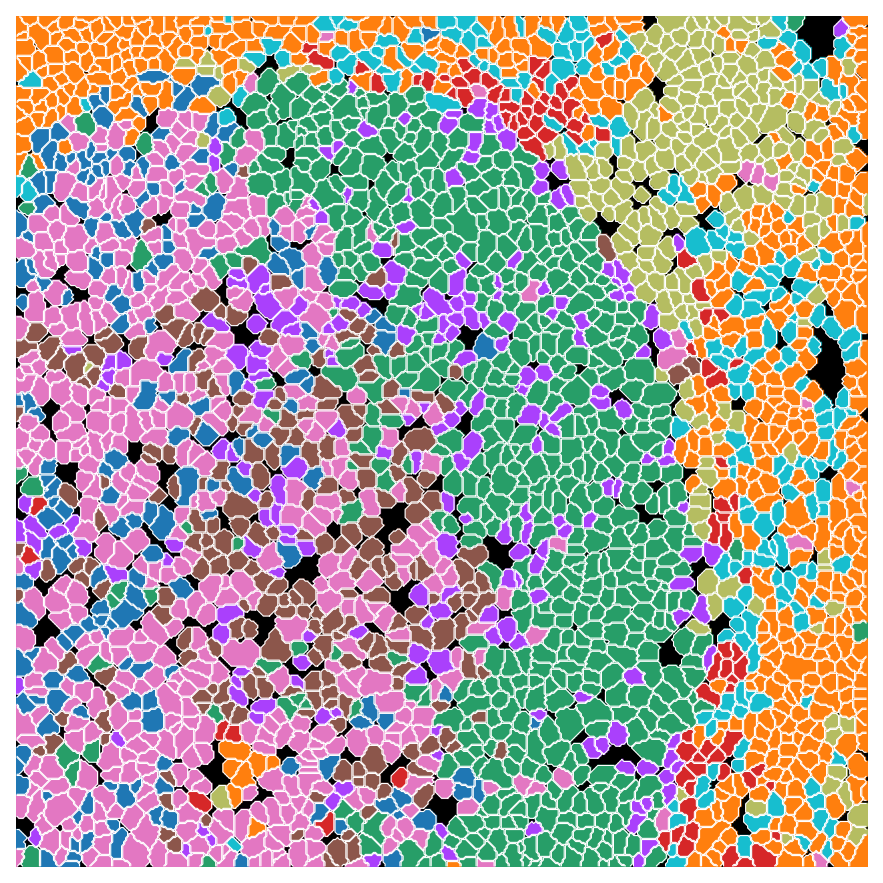

DonorA_2


  0%|          | 0/9 [00:00<?, ?it/s]

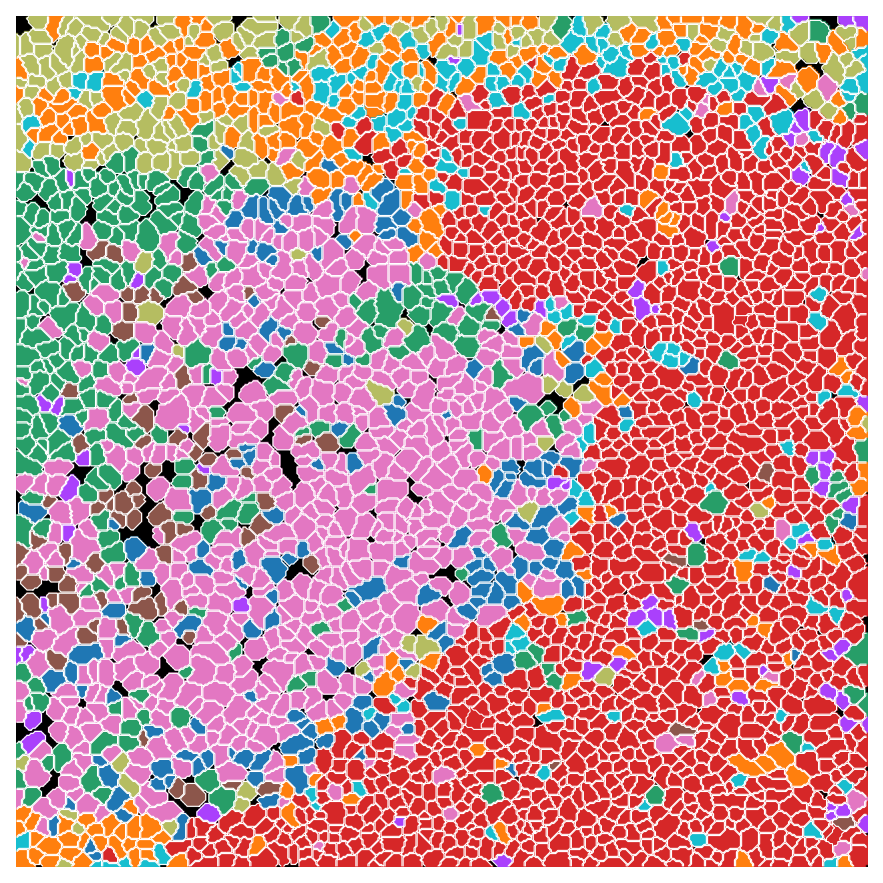

DonorA_3


  0%|          | 0/9 [00:00<?, ?it/s]

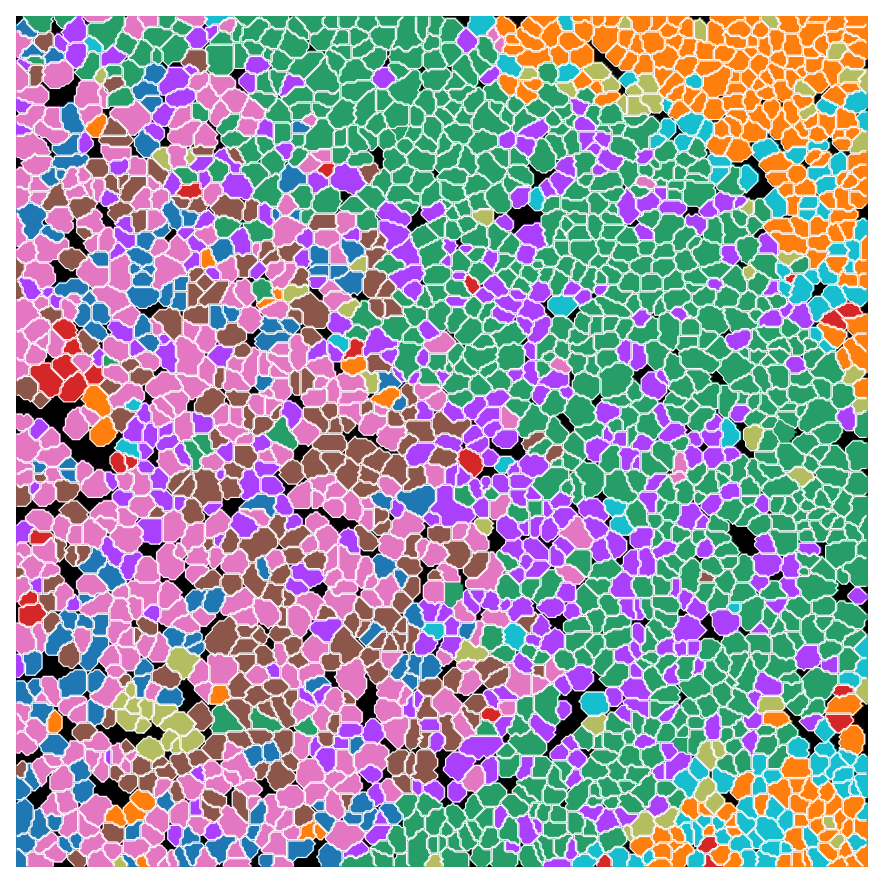

DonorA_4


  0%|          | 0/9 [00:00<?, ?it/s]

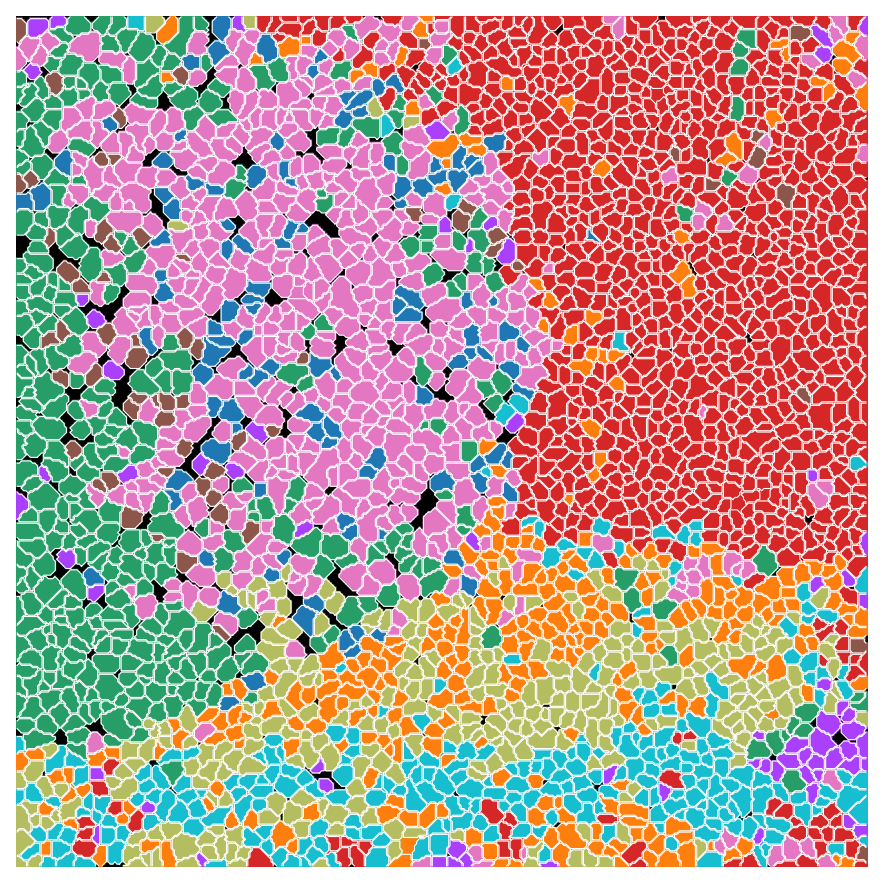

DonorA_5


  0%|          | 0/9 [00:00<?, ?it/s]

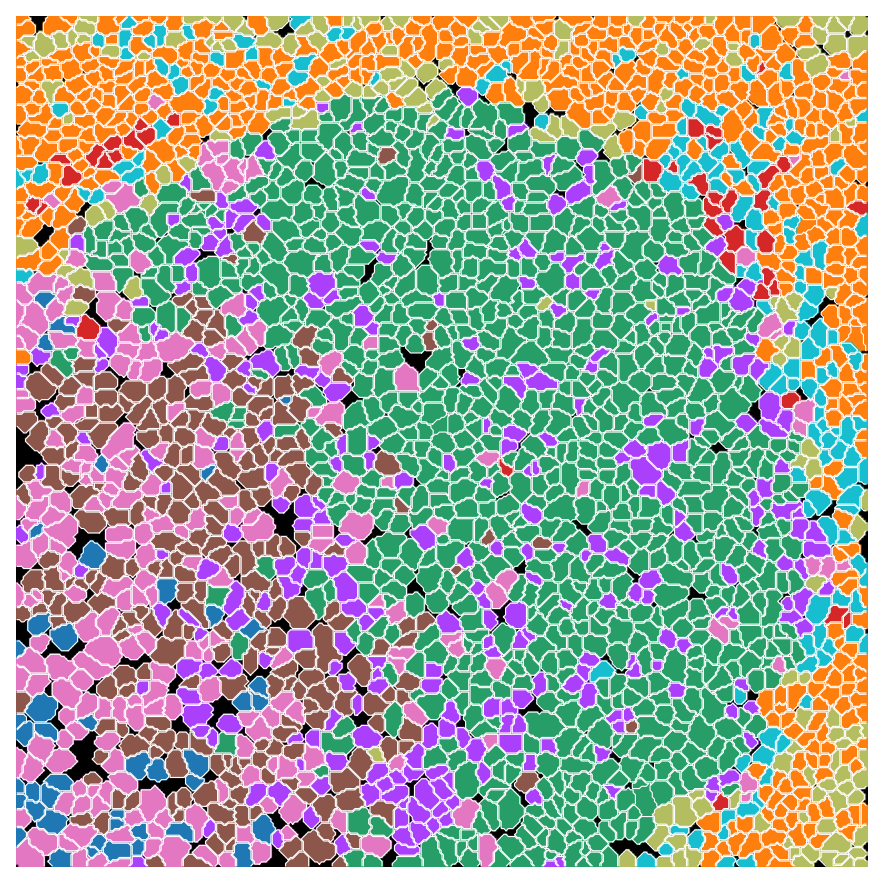

DonorA_6
DonorE_1


  0%|          | 0/9 [00:00<?, ?it/s]

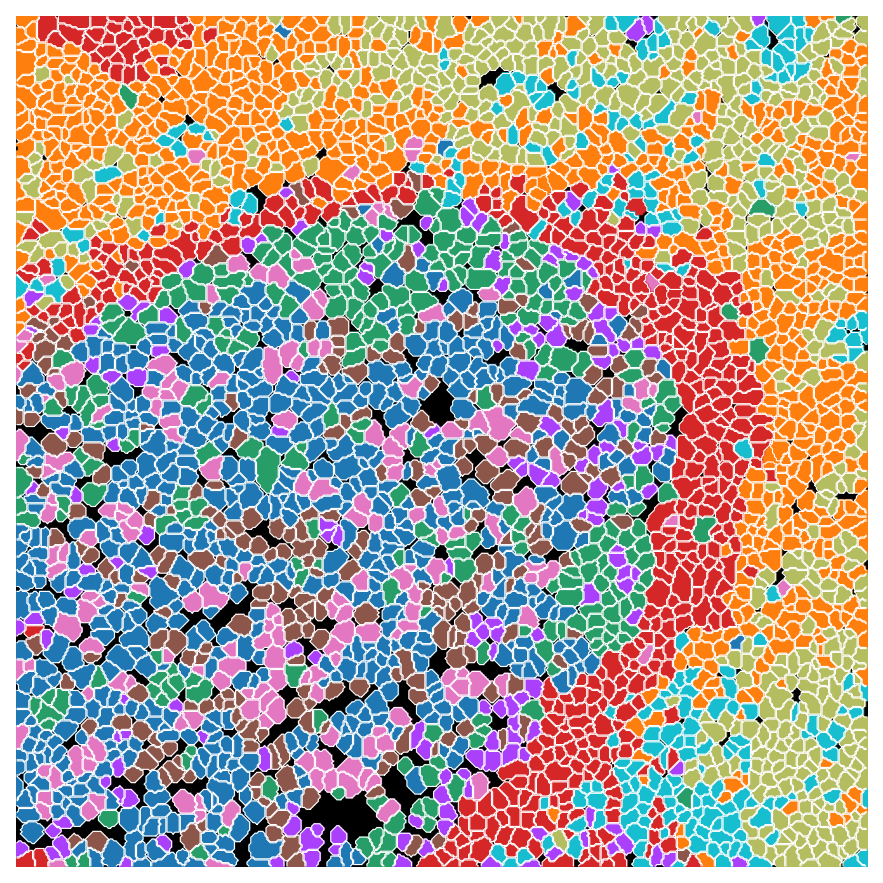

DonorE_2


  0%|          | 0/9 [00:00<?, ?it/s]

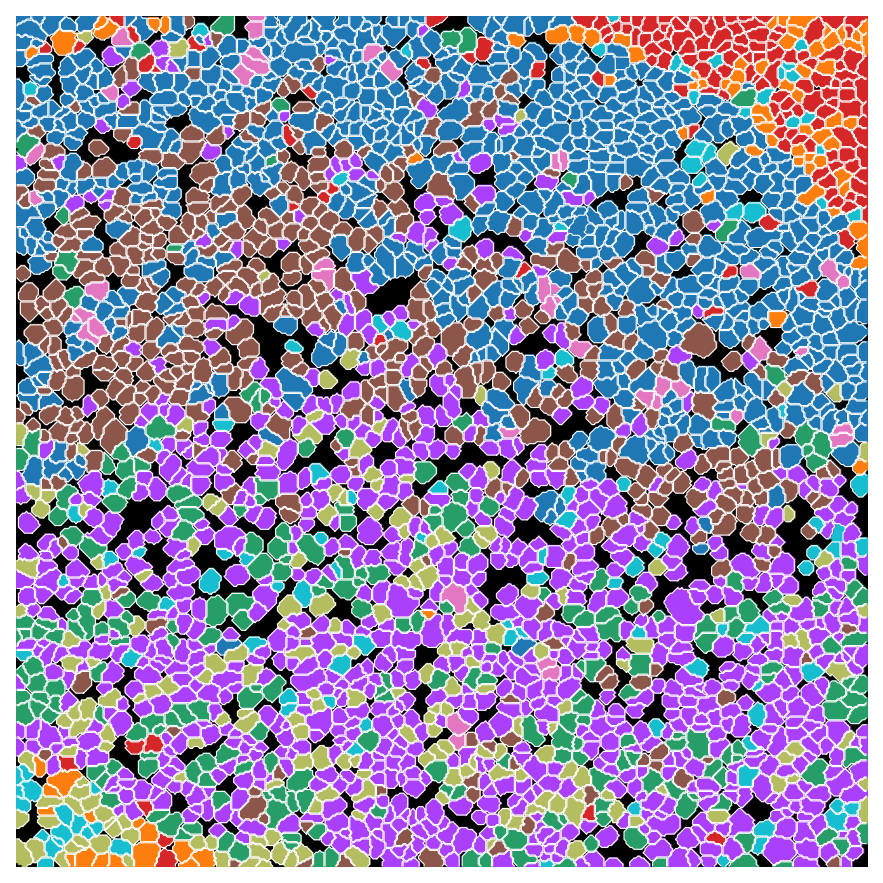

DonorE_3


  0%|          | 0/9 [00:00<?, ?it/s]

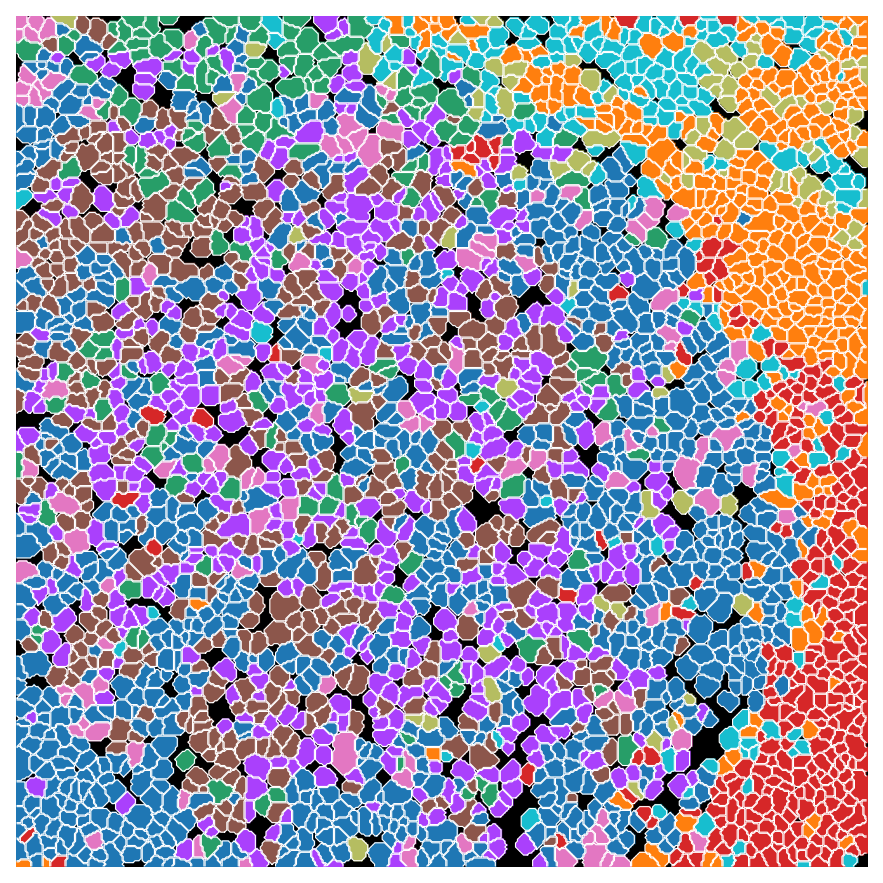

DonorE_4


  0%|          | 0/9 [00:00<?, ?it/s]

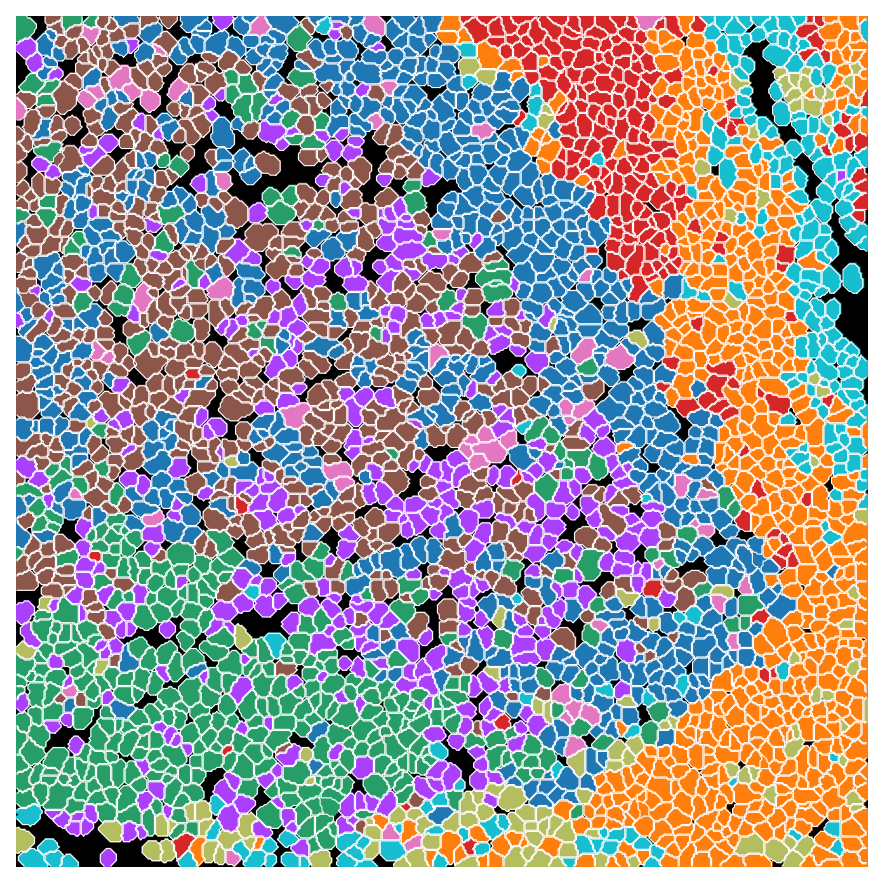

DonorE_5


  0%|          | 0/9 [00:00<?, ?it/s]

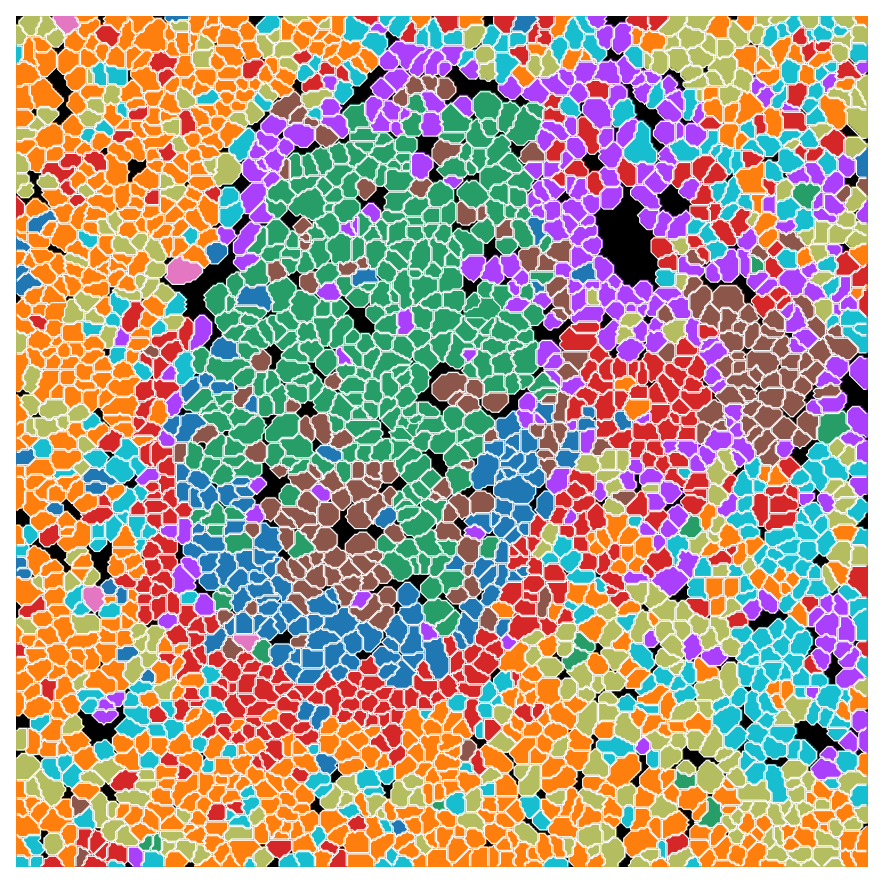

DonorE_6


  0%|          | 0/9 [00:00<?, ?it/s]

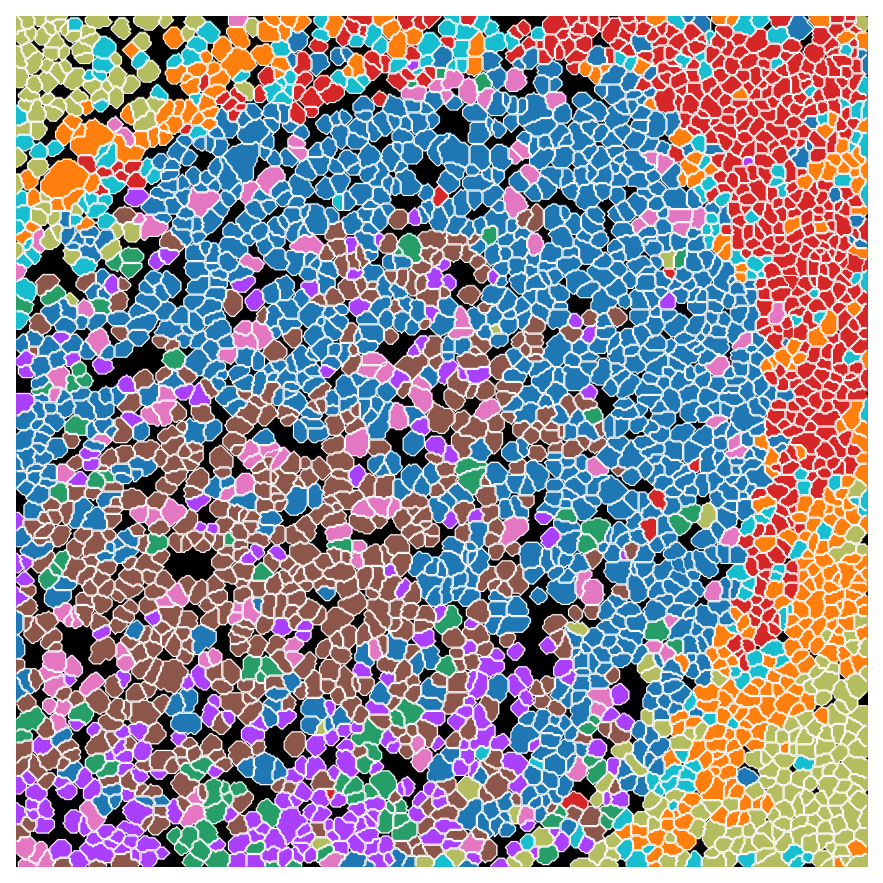

In [37]:

for dataset in datasets:
    print(dataset)
    adata_subset = adata_IMC[adata_IMC.obs.Core == dataset, :]
    try:
        mask = masks["_".join([experiment, dataset])]
        contours = get_contour(mask)
    except:
        continue

    # Get label2cell dict
    label2cell = {}
    for l in labels:
        cell_id = adata_subset[adata_subset.obs.leiden == l].obs.Cell.to_list()
        label2cell[l] = cell_id

    img = create_clustered_cell(mask, label2cell, colors_rgb)

    fig, ax = plt.subplots(figsize=(7, 7))
    ax.imshow(img)
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
    ax.axis("off")
    # fig.savefig(f'{dataset}.png', dpi=100, bbox_inches='tight', transparent=True, pad_inches=0)
    plt.show()

# Region clustering

In [38]:
adata_IMC_region = adata_IMC[:, ['CD20', 'CD21', 'CD3', 'CD4', 'CXCR5', 'H3K27me3', 'Ki67']]

In [39]:
alldata = {}
for batch in adata_IMC_region.obs["Core"].unique():
    adata_subset = adata_IMC_region[
        adata_IMC_region.obs["Core"] == batch,
    ]
    alldata[batch] = adata_subset

# convert to list of AnnData objects
adatas = list(alldata.values())

# run scanorama.integrate
adatas_cor = scanorama.correct_scanpy(adatas, return_dimred=True, return_dense=True, dimred=5)

# make into one matrix.
adata_IMC_region  = ad.concat(adatas_cor)

Found 7 genes among all datasets
[[0.         0.49064654 0.81964879 0.61232018 0.85590551 0.70596883
  0.48588915 0.59729997 0.63740317 0.55126555 0.48469727]
 [0.         0.         0.4437589  0.90219888 0.42559055 0.56777158
  0.36212173 0.49097473 0.4450279  0.50965251 0.42348636]
 [0.         0.         0.         0.48647366 0.82204724 0.49216896
  0.53383203 0.54627432 0.57047935 0.35993136 0.34883721]
 [0.         0.         0.         0.         0.56181102 0.69081456
  0.38252295 0.52998267 0.50051993 0.61990562 0.41317365]
 [0.         0.         0.         0.         0.         0.66803881
  0.4066644  0.48976378 0.59173228 0.47361647 0.31614173]
 [0.         0.         0.         0.         0.         0.
  0.48809174 0.78359306 0.82211114 0.7979408  0.60099971]
 [0.         0.         0.         0.         0.         0.
  0.         0.87385243 0.85379123 0.55729344 0.71922821]
 [0.         0.         0.         0.         0.         0.
  0.         0.         0.90286467 0.7554

C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanorama\scanorama.py:237: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = AnnData(datasets[i])
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanorama\scanorama.py:237: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = AnnData(datasets[i])
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanorama\scanorama.py:237: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pa

In [40]:
sc.pp.neighbors(adata_IMC_region, use_rep="X_scanorama")
sc.tl.umap(adata_IMC_region)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:17)


In [41]:
sc.pp.neighbors(adata_IMC_region, use_rep="X_scanorama", metric='cosine')
sc.tl.leiden(adata_IMC_region, resolution=0.4)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
running Leiden clustering
    finished: found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)


    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_leiden']`


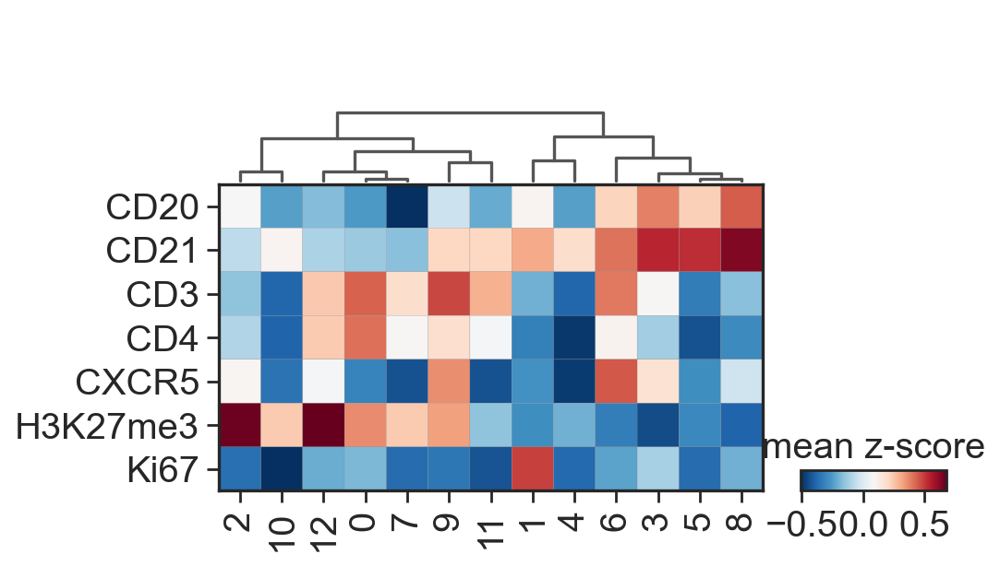

In [42]:
sc.tl.dendrogram(adata_IMC_region, groupby='leiden')
sns.set_context("notebook", font_scale=1.8)
sc.pl.matrixplot(
    adata_IMC_region,
    adata_IMC_region.var_names.tolist(),
    "leiden",
    dendrogram=True,
    colorbar_title="mean z-score",
    cmap="RdBu_r",
    swap_axes=True,
)

C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\scanpy\plotting\_anndata.py:2414: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  obs_tidy.index.value_counts(sort=False).iteritems()


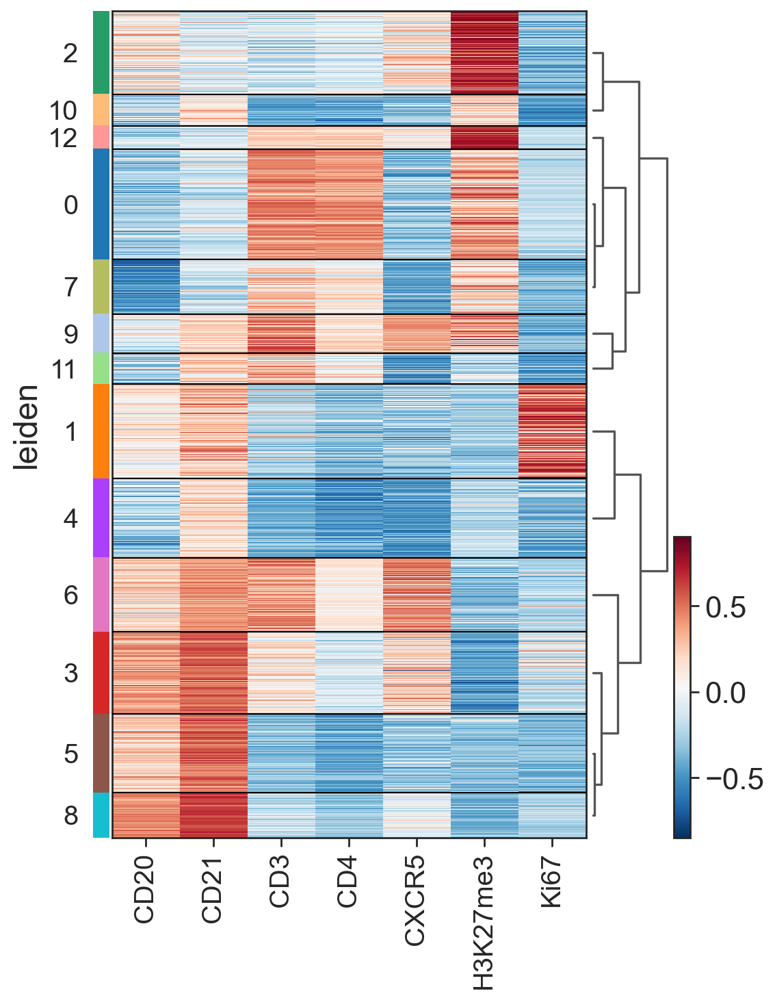

In [43]:
sc.pl.heatmap(
    adata_IMC_region,
    adata_IMC_region.var_names.tolist(),
    "leiden",
    dendrogram=True,
    cmap="RdBu_r",
    figsize=(7, 10),
)

In [44]:
colors = adata_IMC_region.uns["leiden_colors"]
labels = np.unique(adata_IMC_region.obs.leiden.tolist())

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

DonorA_1


  0%|          | 0/13 [00:00<?, ?it/s]

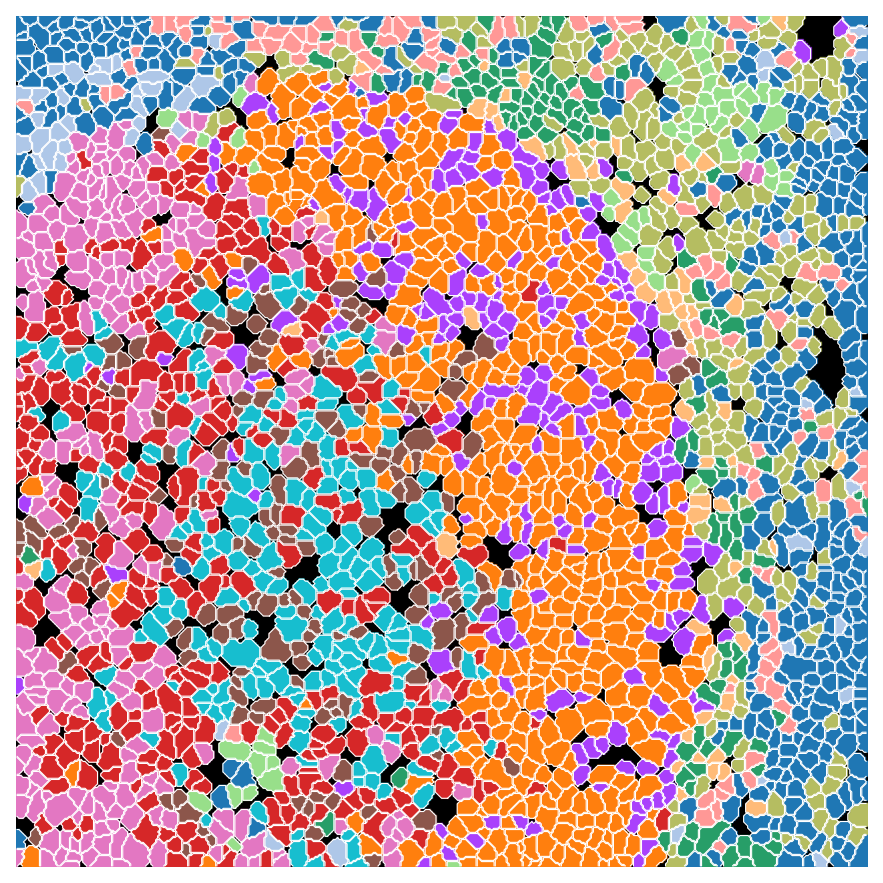

DonorA_2


  0%|          | 0/13 [00:00<?, ?it/s]

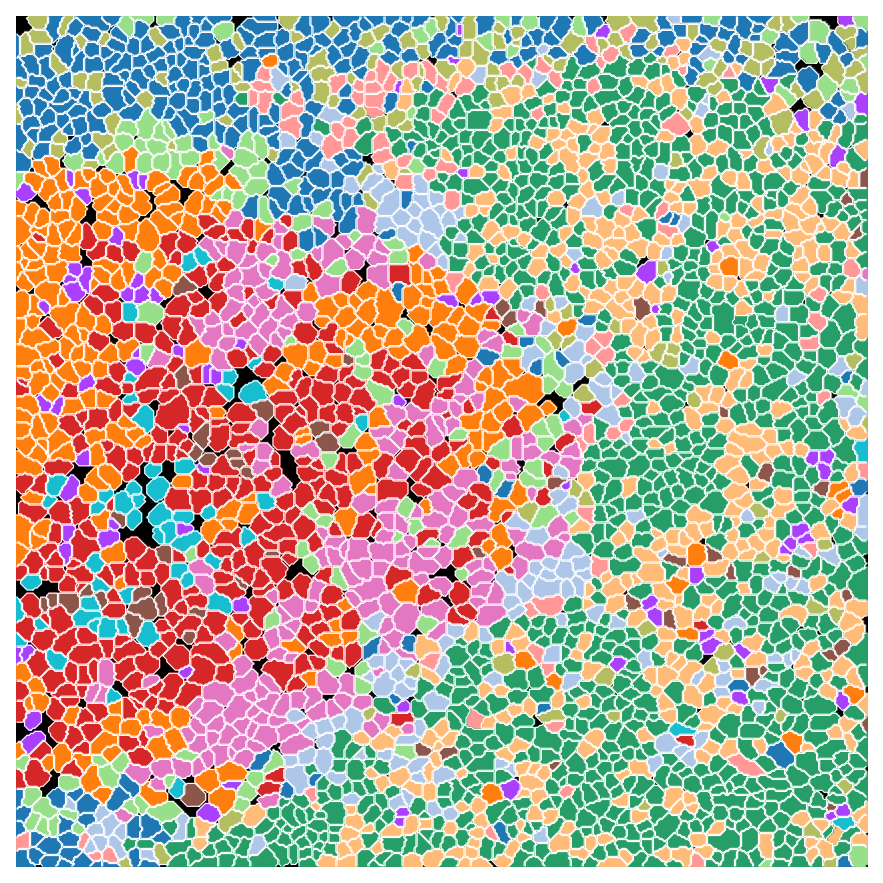

DonorA_3


  0%|          | 0/13 [00:00<?, ?it/s]

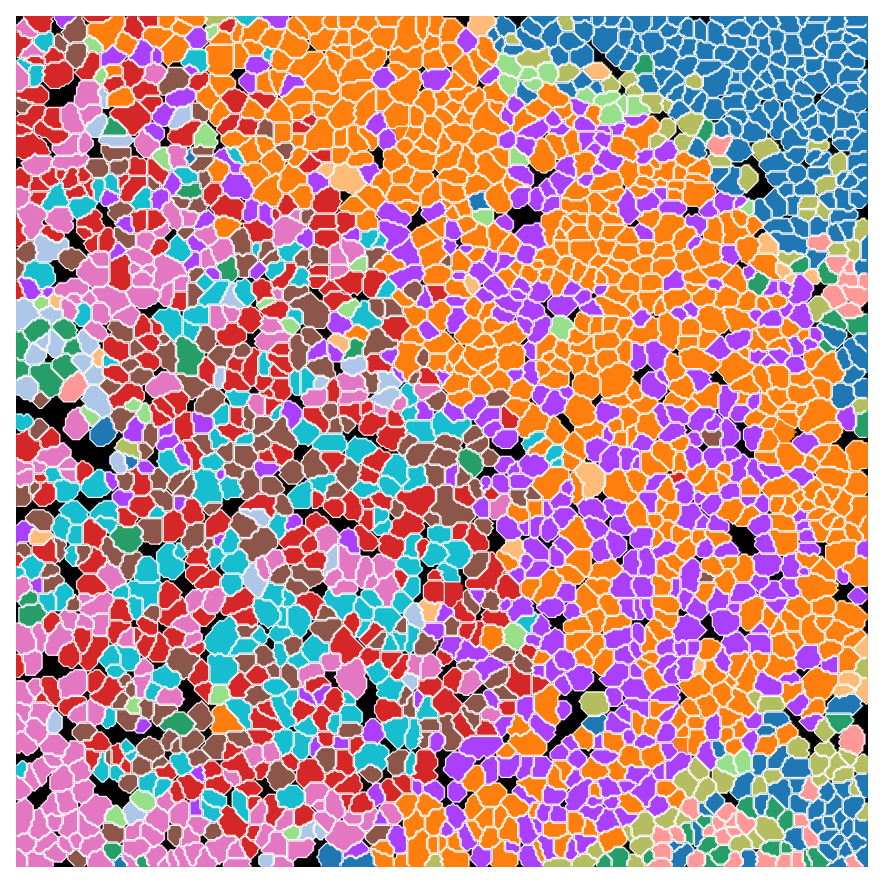

DonorA_4


  0%|          | 0/13 [00:00<?, ?it/s]

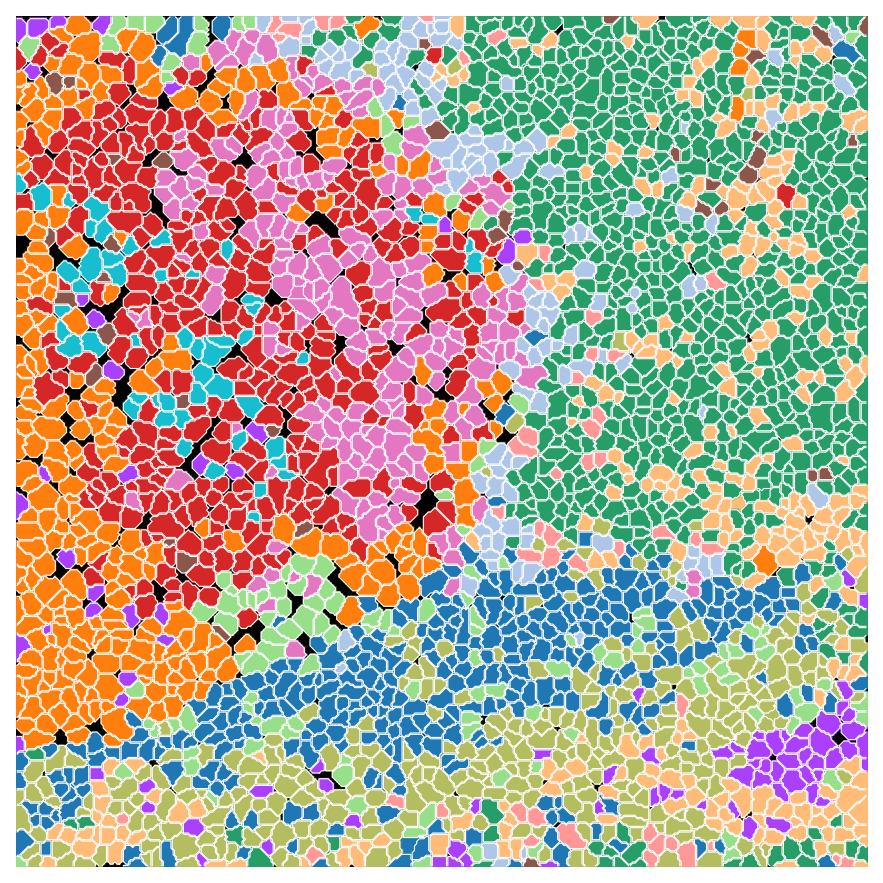

DonorA_5


  0%|          | 0/13 [00:00<?, ?it/s]

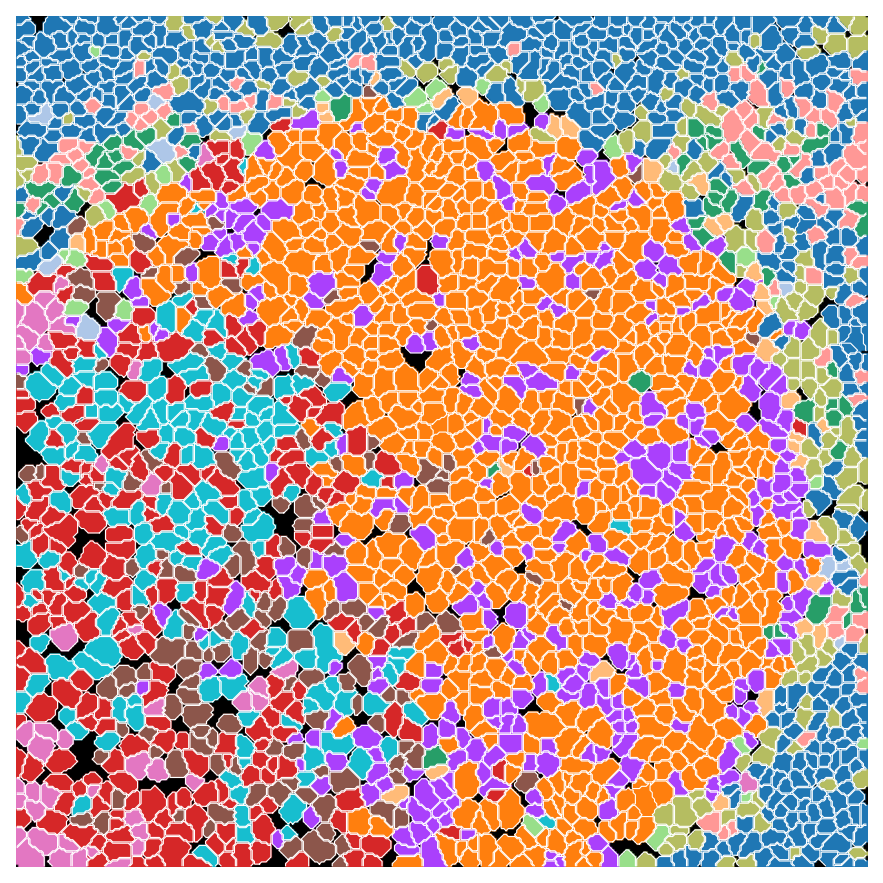

DonorA_6
DonorE_1


  0%|          | 0/13 [00:00<?, ?it/s]

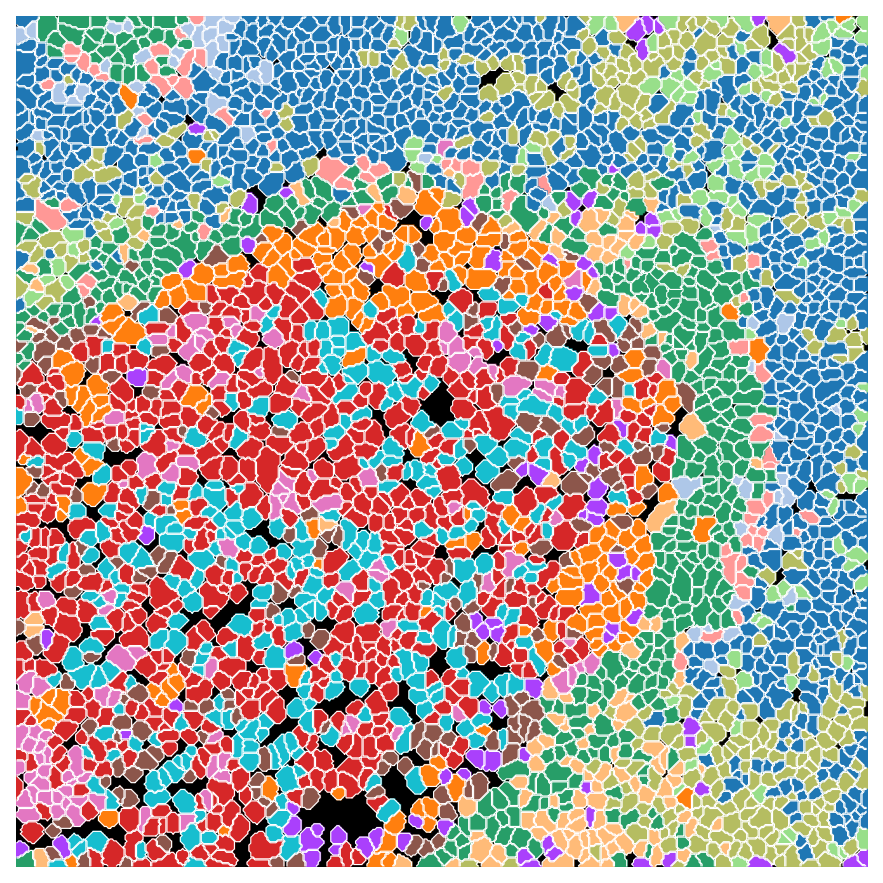

DonorE_2


  0%|          | 0/13 [00:00<?, ?it/s]

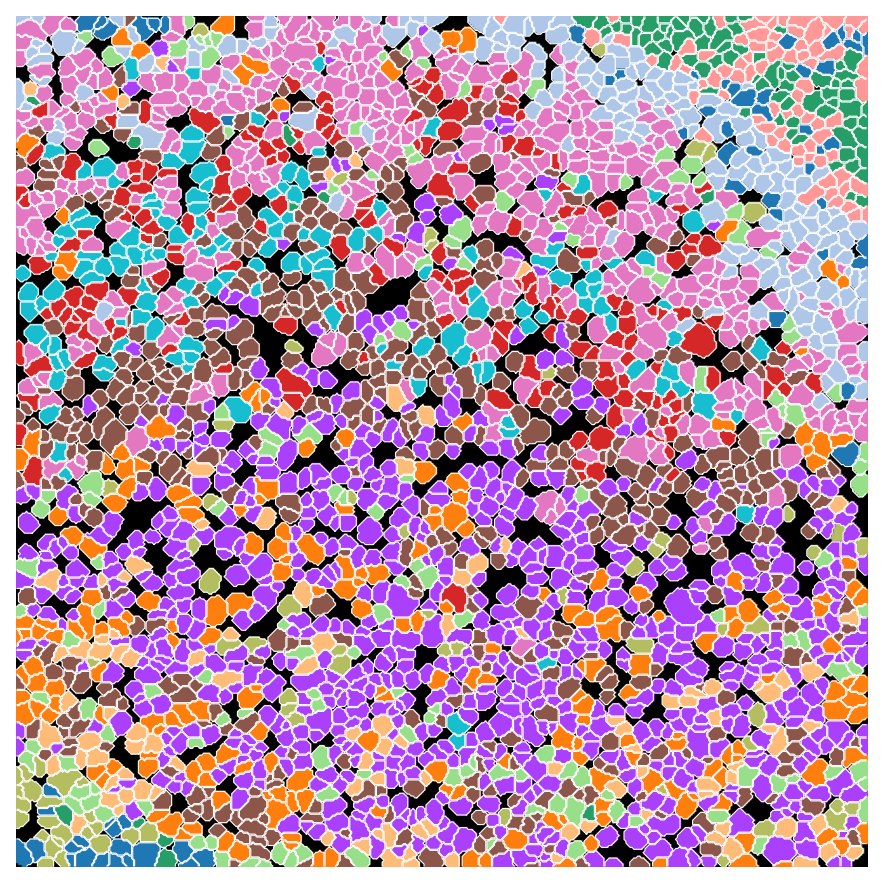

DonorE_3


  0%|          | 0/13 [00:00<?, ?it/s]

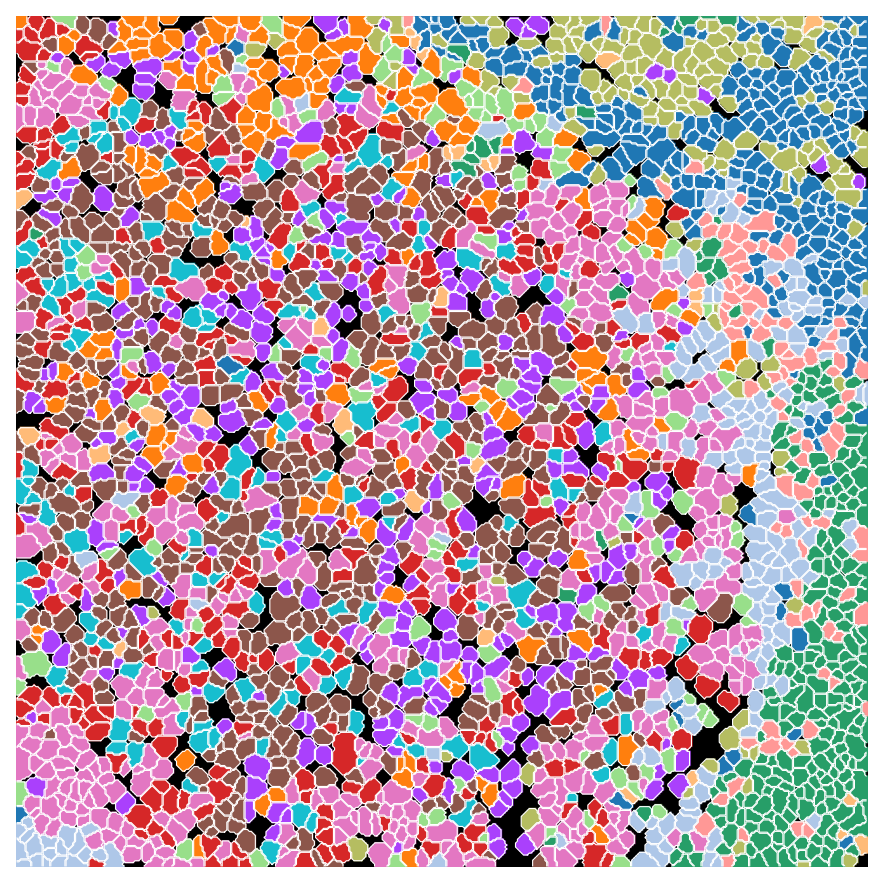

DonorE_4


  0%|          | 0/13 [00:00<?, ?it/s]

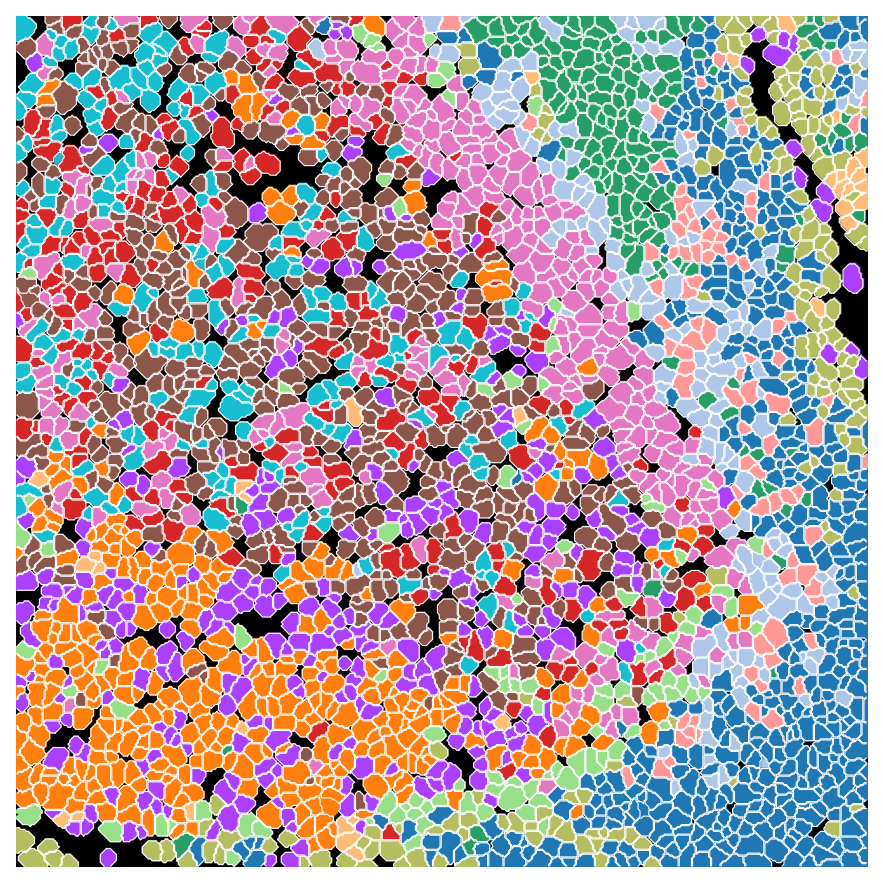

DonorE_5


  0%|          | 0/13 [00:00<?, ?it/s]

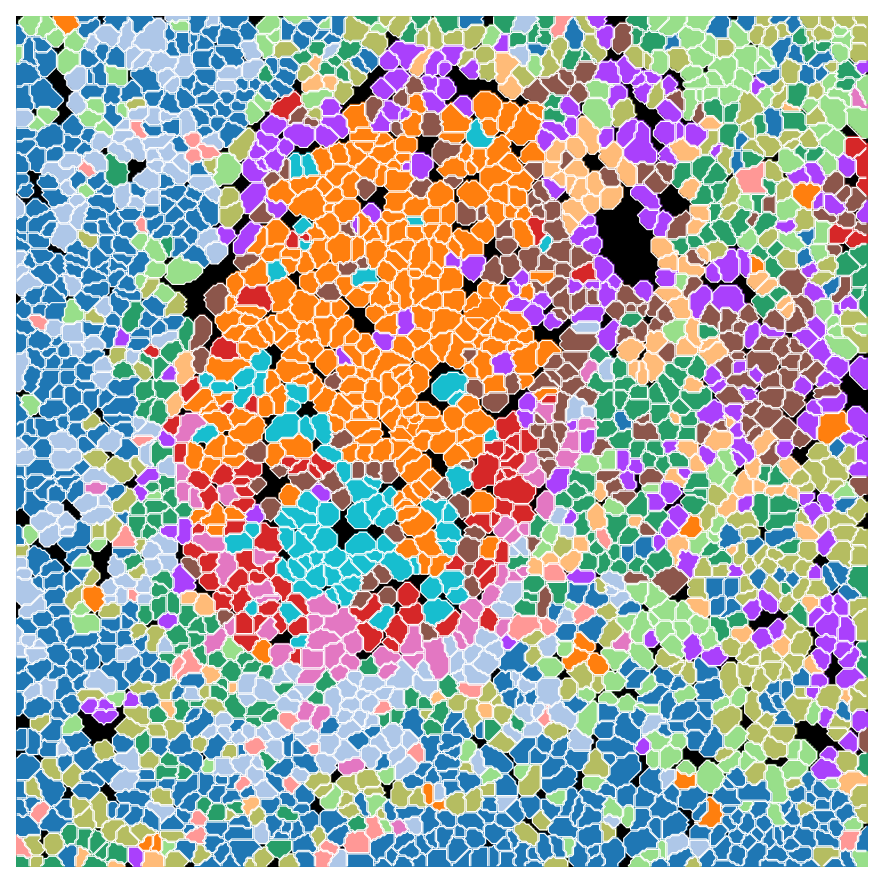

DonorE_6


  0%|          | 0/13 [00:00<?, ?it/s]

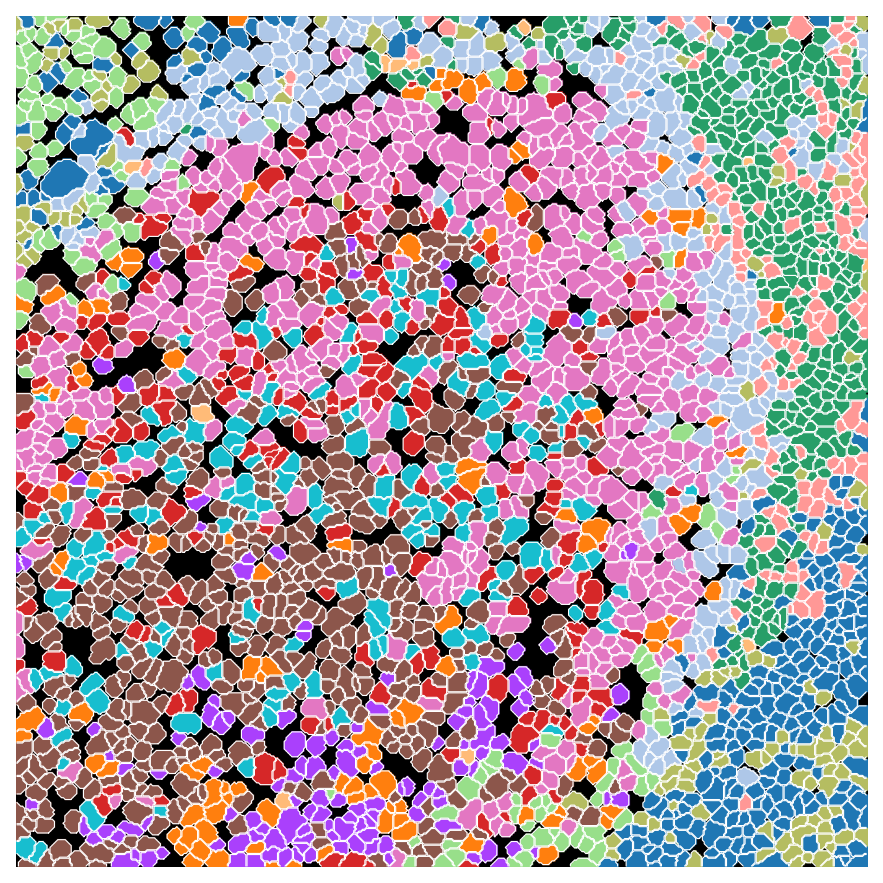

In [45]:

for dataset in datasets:
    print(dataset)
    adata_subset = adata_IMC_region[adata_IMC_region.obs.Core == dataset, :]
    try:
        mask = masks["_".join([experiment, dataset])]
        contours = get_contour(mask)
    except:
        continue

    # Get label2cell dict
    label2cell = {}
    for l in labels:
        cell_id = adata_subset[adata_subset.obs.leiden == l].obs.Cell.to_list()
        label2cell[l] = cell_id

    img = create_clustered_cell(mask, label2cell, colors_rgb)

    fig, ax = plt.subplots(figsize=(7, 7))
    ax.imshow(img)
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
    ax.axis("off")
    plt.show()

In [46]:
type_dict = {'0': 'T-cells Outside GC',
            '1': 'GC DZ',
            '2': 'B cell Outside GC', 
            '3': 'B cell in GC',
            '4': 'GC DZ',
            '5': 'FDC',
            '6': 'TFH',
            '7': 'T-cells Outside GC',
            '8': 'FDC',
            '9': 'T-cells Outside GC',
            '10': 'B cell Outside GC',
            '11': 'T-cells Outside GC',
            '12': 'T-cells Outside GC',
            }

In [47]:
adata_IMC_region.obs['Type'] = (
    adata_IMC_region.obs['leiden']
    .map(type_dict)
    .astype("category")
)
adata_IMC_region.uns['Type_colors'] = adata_IMC_region.uns['leiden_colors'][:len(np.unique(adata_IMC_region.obs['Type']))]

In [48]:
sc.tl.dendrogram(adata_IMC_region, groupby='Type')

cluster_label_order = adata_IMC_region.uns['dendrogram_Type']['categories_ordered']
colors = adata_IMC_region.uns["Type_colors"]
labels = adata_IMC_region.obs.Type.cat.categories.tolist()

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

colors_rgb_dict = {k:v for k,v in zip(labels, colors_rgb)}

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_Type']`


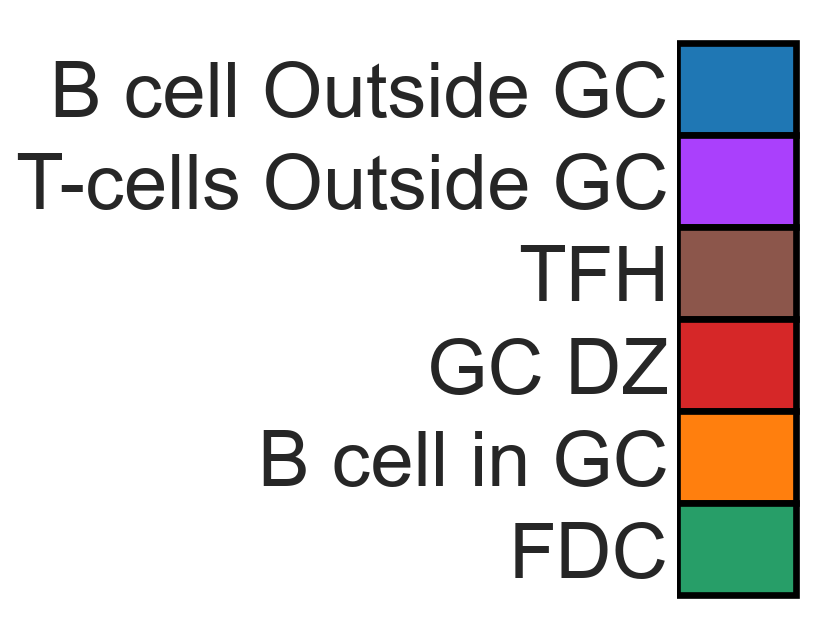

In [49]:
c=np.array([colors_rgb_dict[i] for i in cluster_label_order])

# legend
fig, ax = plt.subplots(figsize=(1,5))
ax.barh(y=range(len(colors_rgb_dict.values())), 
        color=c/255,
        width=1, 
        height=1,
        edgecolor='k',
        linewidth=3,
       )
_ = plt.yticks(range(len(colors_rgb_dict.values())), cluster_label_order, rotation=0, size=35)
_ = plt.xticks([])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.tick_params(axis=u'both', which=u'both',length=0)
# ax.yaxis.tick_right()
ax.invert_yaxis()
ax.grid(False)


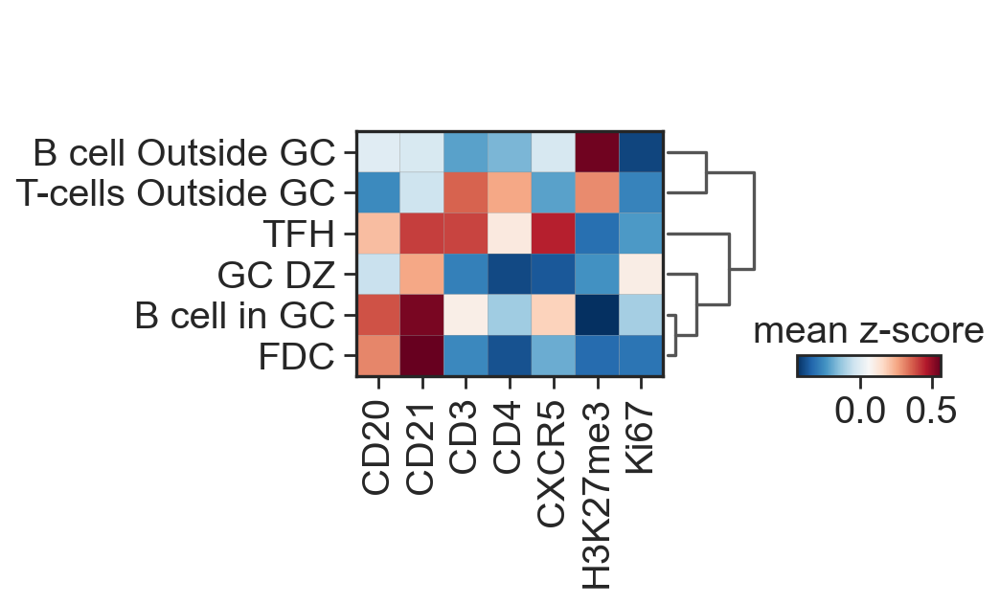

In [50]:
sc.pl.matrixplot(
    adata_IMC_region,
    adata_IMC_region.var_names.tolist(),
    "Type",
    dendrogram=True,
    colorbar_title="mean z-score",
    cmap="RdBu_r",
    swap_axes=False,
)

KeyError: 'Could not find key Type in .var_names or .obs.columns.'

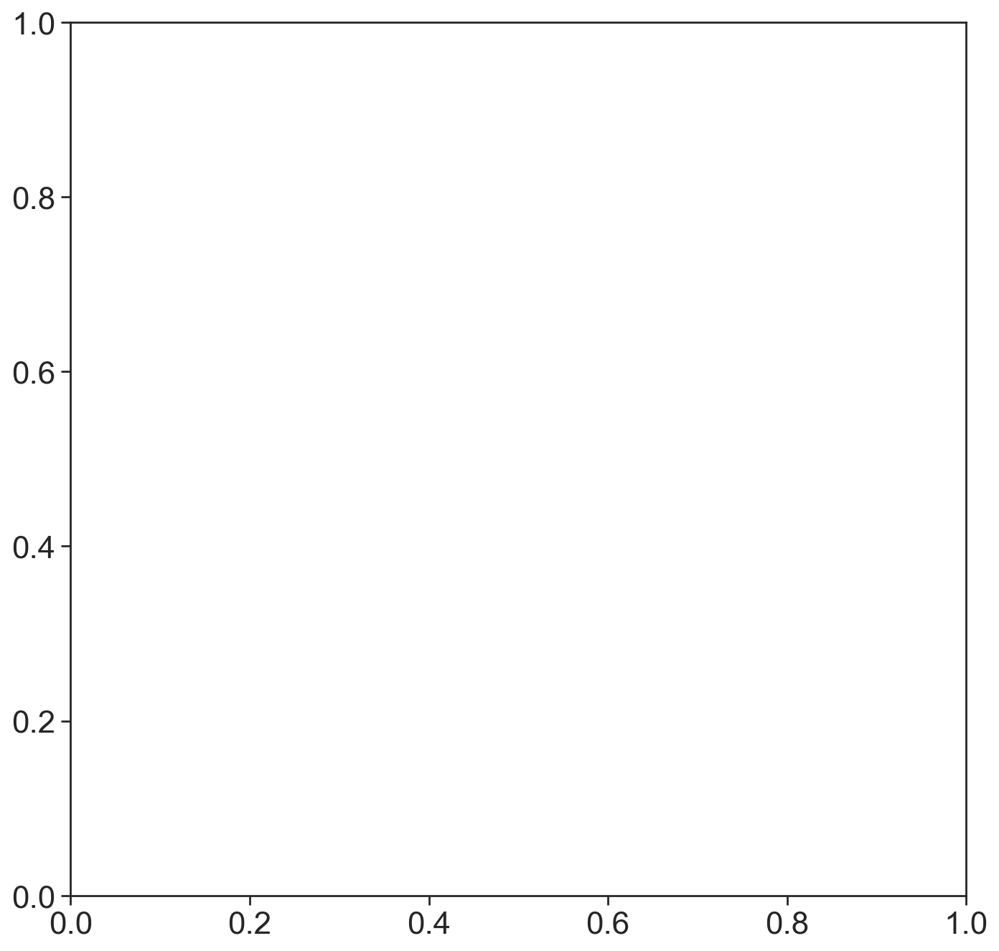

In [51]:
with rc_context({"figure.figsize": (10, 10)}):
    sc.pl.umap(
        adata_IMC,
        color=["Type"],
        size=100,
        legend_loc="on data",
        add_outline=True,
        legend_fontsize=20,
        legend_fontoutline=2,
        frameon=False,
        title="clustering of cells",
    )

In [ ]:
var = 'Type'
colors = adata_IMC_region.uns[f"{var}_colors"]
labels = np.unique(adata_IMC_region.obs[var].tolist())

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

In [ ]:
experiment = 'tonsil'

for dataset in datasets:
    try:
        adata_subset = adata_IMC_region[adata_IMC_region.obs.Core == dataset, :]
        mask = masks[experiment + '_' + dataset]
        contours = get_contour(mask)
    except:
        print(f'{dataset} cannot be read') 
        continue
    
    print(f'{dataset}') 
    # Get label2cell dict
    label2cell = {}
    for j, l in enumerate(labels):
        cell_id = adata_subset[adata_subset.obs[var] == l].obs.Cell.to_list()
        label2cell[j] = cell_id

    img = create_clustered_cell(mask, label2cell, colors_rgb)

    fig, ax = plt.subplots(figsize=(5, 5))
    ax.imshow(img)
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
    ax.axis("off")
    fig.savefig(f'Type_{dataset}.png', dpi=100, bbox_inches='tight', transparent=True, pad_inches=0)
    plt.show()

## Get statisitcs

In [ ]:
df_test = pd.DataFrame()
df_test["Dataset"] = adata_IMC.obs["Core"].tolist()
df_test["Clusters"] = adata_IMC.obs["Type"].tolist()

In [ ]:
clusters = df_test["Clusters"].unique().tolist()

In [ ]:
df_test_grouped = (
    df_test.groupby("Dataset")["Clusters"]
    .value_counts(normalize=True)
    .rename("Percentage")
    .mul(100)
    .reset_index()
)

sns.set_style('white')
sns.set_context("talk", font_scale=2)

sns.barplot(
    data=df_test_grouped,
    x="Clusters",
    y="Percentage",
    hue="Dataset",
    order=[i for i in clusters],
)
plt.xticks(rotation=30, ha='right')
plt.gcf().set_size_inches(15, 5)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)


In [ ]:
# Add to original data
adata_IMC.obs['Type'] = adata_IMC_region.obs['Type']
adata_IMC.uns['Type_colors'] = adata_IMC_region.uns['Type_colors']

## CN


In [52]:
from sklearn.neighbors import NearestNeighbors
from kneed import KneeLocator
from sklearn.cluster import MiniBatchKMeans
from matplotlib.ticker import MaxNLocator
from skimage import morphology, measure, exposure
from scipy import ndimage


def get_NN(adata, n):
    data = adata.obsm["spatial"]
    # fit = NearestNeighbors(n_neighbors=n + 1).fit(data)
    fit = NearestNeighbors(n_neighbors=n).fit(data)
    m = fit.kneighbors(data)
    # m = m[0][:, 1:], m[1][:, 1:]
    m = m[0], m[1] # Distances, Indices

    # sort_neighbors
    args = m[0].argsort(axis=1)
    add = (
        np.arange(m[1].shape[0]) * m[1].shape[1]
    )  # arange for number of elements with step of number of neighbors
    sorted_indices = m[1].flatten()[
        args + add[:, None]
    ]  # Extract indices in sorted order
    return sorted_indices


def neighbor_frequency(adata, n, var='leiden'):
    dummies = pd.get_dummies(adata.obs[var]).values
    cols = get_NN(adata, n)
    window = dummies[cols].flatten()
    window = window.reshape(-1, n, dummies.shape[1])
    window = window.sum(axis=1) / n
    assert len(window) == len(adata.X)
    return window

In [53]:
n_neighbors = 20
windows = []

for d in adata_IMC_region.obs.Core.unique():
    adata_subset = adata_IMC_region[adata_IMC_region.obs.Core == d, :]

    # sq.gr.spatial_neighbors(adata_subset, n_neighs=n_neighbors)
    window = neighbor_frequency(adata_subset, n_neighbors, var='leiden')
    assert len(window) == len(adata_subset.X)

    windows.append(window)

windows = np.concatenate(windows)
windows.shape

(31156, 13)

In [54]:
adata_CN = ad.AnnData(windows)
adata_CN.raw = adata_IMC_region.copy()
adata_CN.obs = adata_IMC_region.obs.copy()
adata_CN.uns = adata_IMC_region.uns.copy()
adata_CN.obsm = adata_IMC_region.obsm.copy()
adata_CN.obsp = adata_IMC_region.obsp.copy() 
adata_CN.var_names = pd.get_dummies(adata_IMC_region.obs["leiden"]).columns.to_list()

C:\Users\thu71\AppData\Local\Temp\ipykernel_8212\4064295764.py:1: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata_CN = ad.AnnData(windows)
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


computing PCA
    with n_comps=5
    finished (0:00:00)


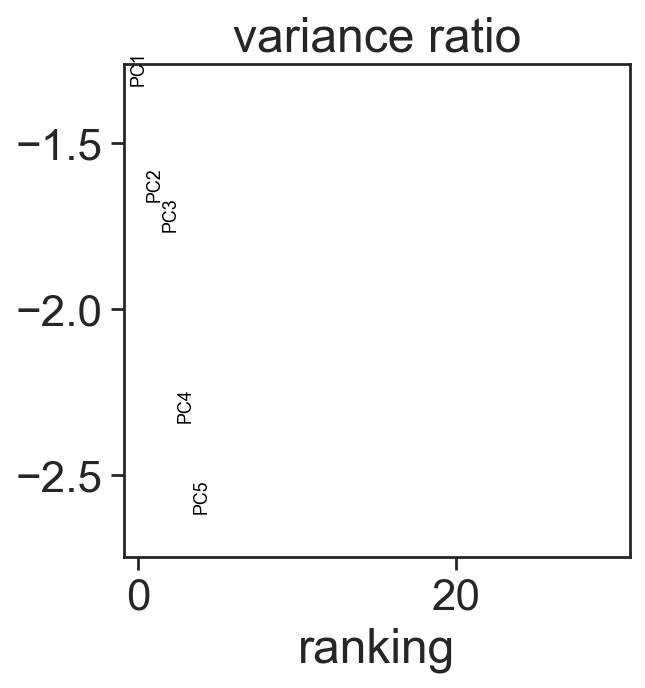

In [55]:
sc.tl.pca(adata_CN, n_comps=5)
sc.pl.pca_variance_ratio(adata_CN, log=True)


C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable 

The suggested number of clusters =  4


C:\Users\thu71\AppData\Local\Temp\ipykernel_8212\651735786.py:30: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  plt.title("The suggested number of clusters = " + np.str(kneedle_point.knee))


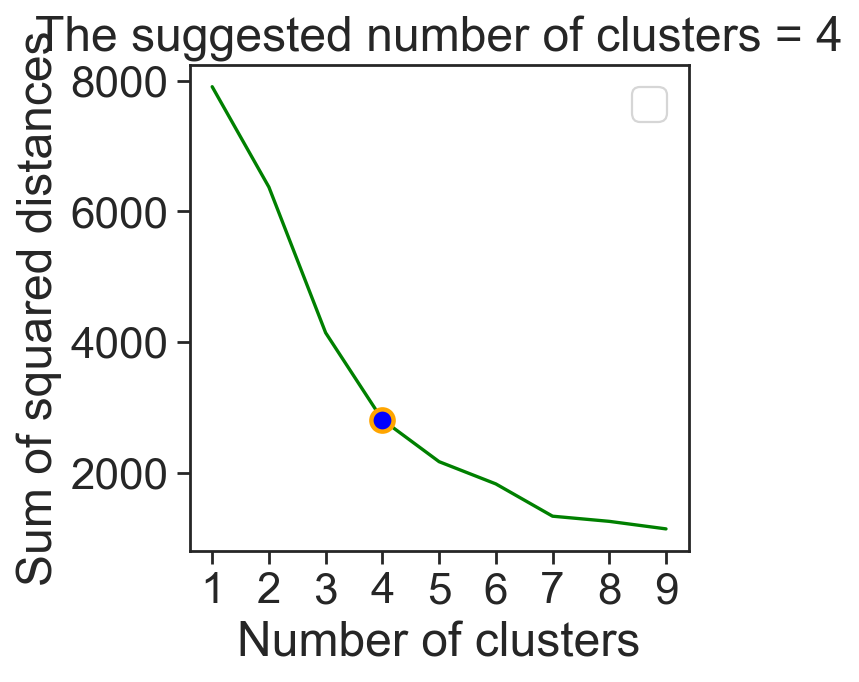

In [56]:
proj_3d = adata_CN.obsm['X_pca']

n_components = np.arange(1, 10)
models = [
    MiniBatchKMeans(random_state=5, n_clusters=n).fit(proj_3d) for n in n_components
]

BIC_Scores = [m.inertia_ for m in models]
kneedle_point = KneeLocator(
    n_components, BIC_Scores, curve="convex", direction="decreasing"
)
print("The suggested number of clusters = ", kneedle_point.knee)
Elbow_idx = np.where(BIC_Scores == kneedle_point.knee_y)[0]

plt.plot(
    n_components,
    BIC_Scores,
    "-g",
    marker="o",
    markerfacecolor="blue",
    markeredgecolor="orange",
    markeredgewidth="2",
    markersize=10,
    markevery=Elbow_idx,
)
plt.gca().xaxis.set_major_locator(MaxNLocator(integer=True))
plt.legend(loc="best")
plt.xlabel("Number of clusters")
plt.ylabel("Sum of squared distances")
plt.title("The suggested number of clusters = " + np.str(kneedle_point.knee))
plt.show()

In [57]:
n_neighborhoods = 4

km = MiniBatchKMeans(n_clusters=n_neighborhoods, random_state=0)

labels = km.fit_predict(proj_3d)
k_centroids = km.cluster_centers_

C:\Users\thu71\Anaconda3\envs\scspamet\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


In [58]:
adata_CN.obs["CN"] = labels
adata_CN.obs["CN"] = adata_CN.obs["CN"].astype("category")
adata_CN.uns["CN_colors"] = adata_IMC_region.uns["leiden_colors"][:len(np.unique(labels))]

    using data matrix X directly
Storing dendrogram info using `.uns['dendrogram_CN']`


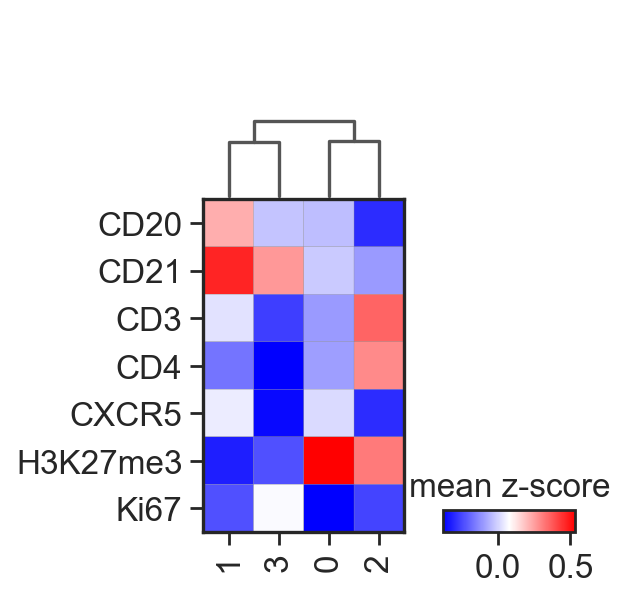

In [59]:
sc.tl.dendrogram(adata_CN, groupby='CN')

sns.set_context("notebook", font_scale=1.5)
sc.pl.matrixplot(
    adata_CN,
    adata_CN.raw.var_names.tolist(),
    "CN",
    dendrogram=True,
    colorbar_title="mean z-score",
    cmap='bwr',
    swap_axes=True,
    use_raw=True,
    # vmin=0,
    # vmax=0.3
)

In [60]:
cluster_label_order = adata_CN.uns['dendrogram_CN']['categories_ordered']

In [61]:
import matplotlib 

colors = adata_CN.uns["CN_colors"]
labels = adata_CN.obs.CN.cat.categories.tolist()

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

colors_rgb_dict = {k:v for k,v in zip(labels, colors_rgb)}

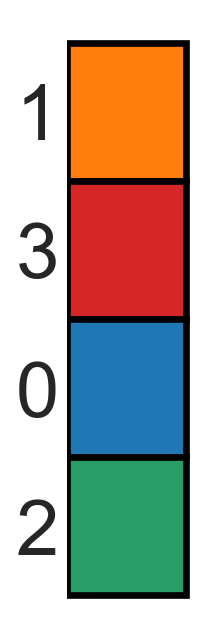

In [62]:
c=np.array([colors_rgb_dict[i] for i in cluster_label_order])

# legend
fig, ax = plt.subplots(figsize=(1,5))
ax.barh(y=range(len(colors_rgb_dict.values())), 
        color=c/255,
        width=1, 
        height=1,
        edgecolor='k',
        linewidth=3,
       )
_ = plt.yticks(range(len(colors_rgb_dict.values())), cluster_label_order, rotation=0, size=35)
_ = plt.xticks([])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.tick_params(axis=u'both', which=u'both',length=0)
# ax.yaxis.tick_right()
ax.invert_yaxis()
ax.grid(False)


In [63]:
colors = adata_CN.uns["CN_colors"]
labels = np.unique(adata_CN.obs.CN.tolist())

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

  0%|          | 0/4 [00:00<?, ?it/s]

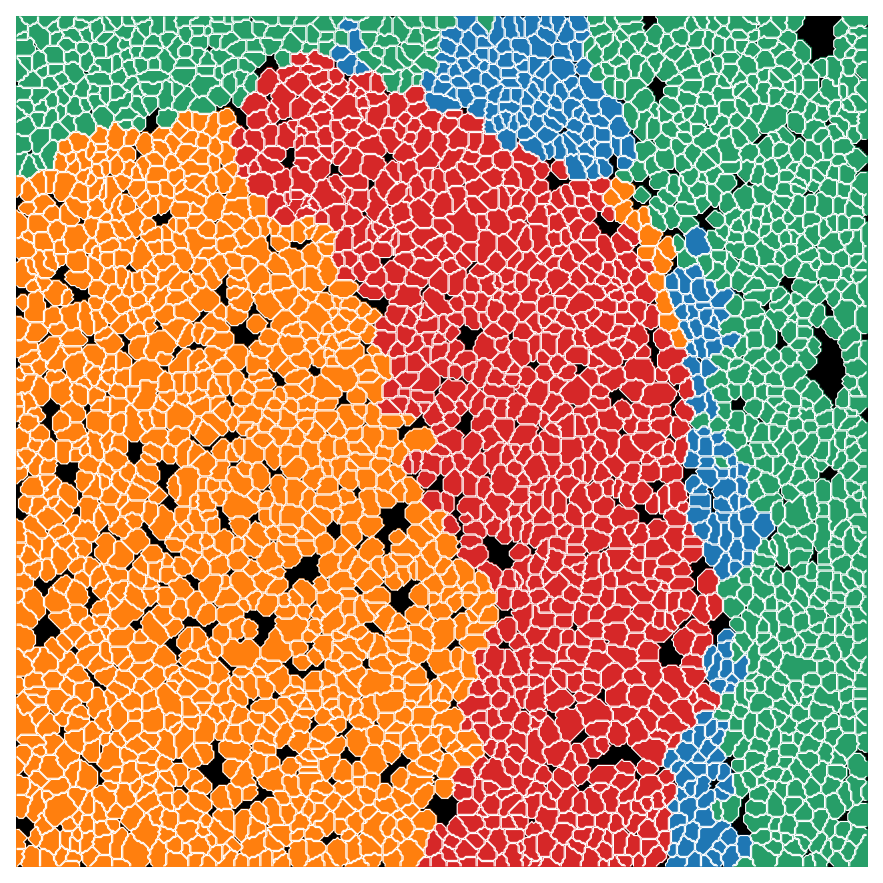

  0%|          | 0/4 [00:00<?, ?it/s]

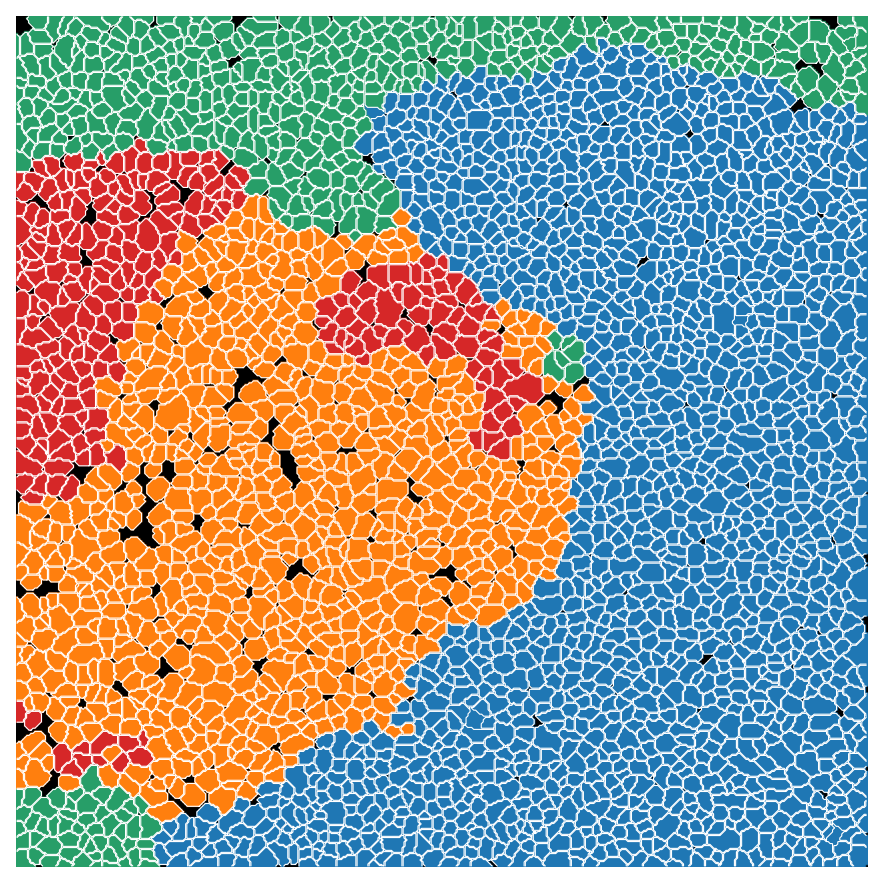

  0%|          | 0/4 [00:00<?, ?it/s]

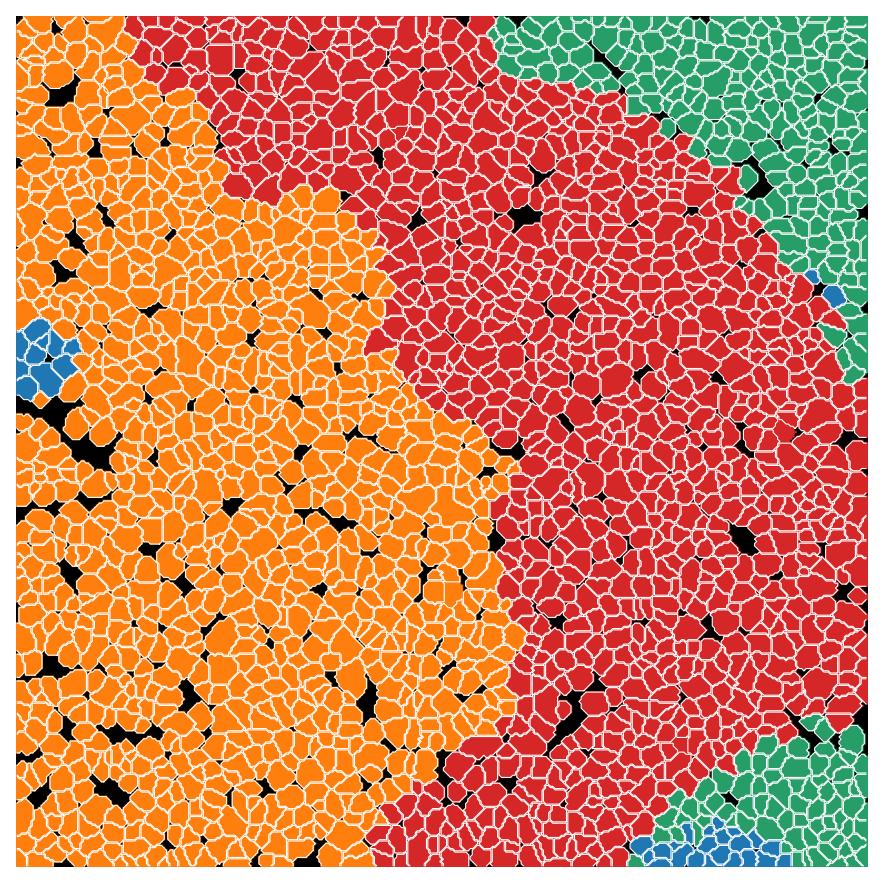

  0%|          | 0/4 [00:00<?, ?it/s]

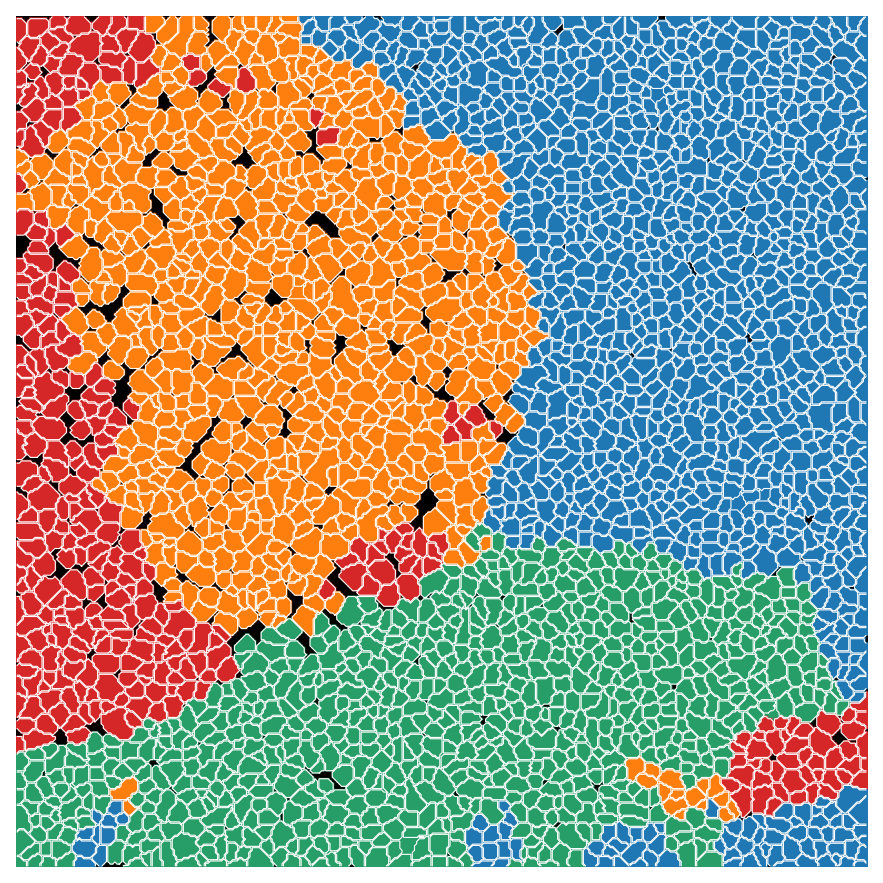

  0%|          | 0/4 [00:00<?, ?it/s]

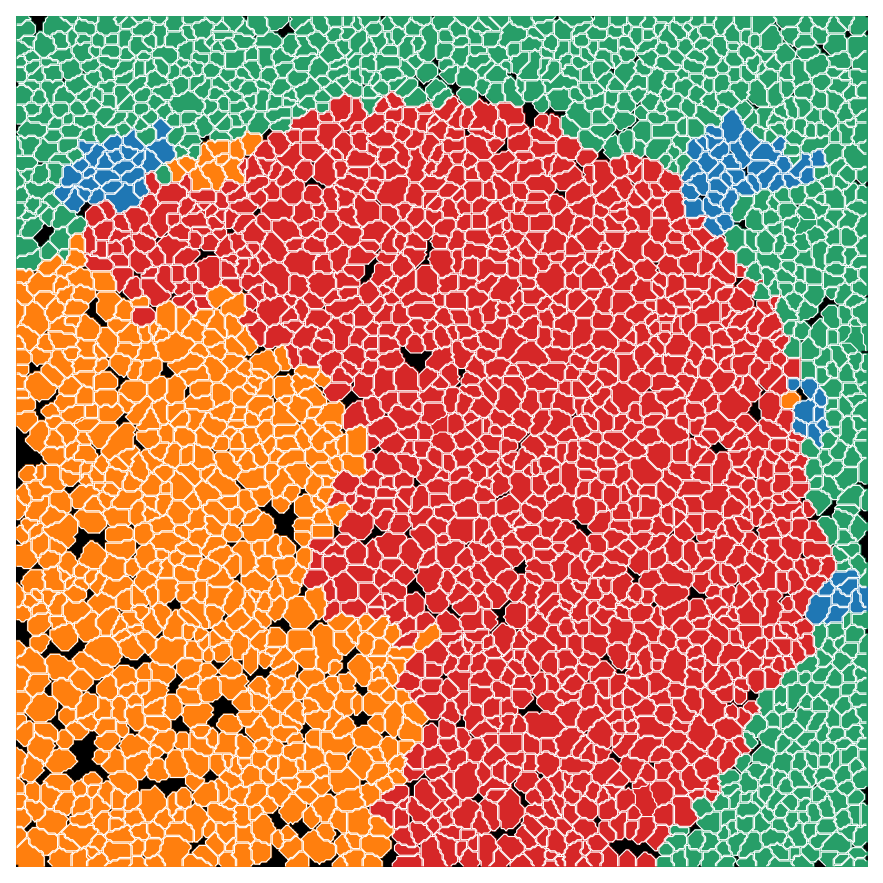

  0%|          | 0/4 [00:00<?, ?it/s]

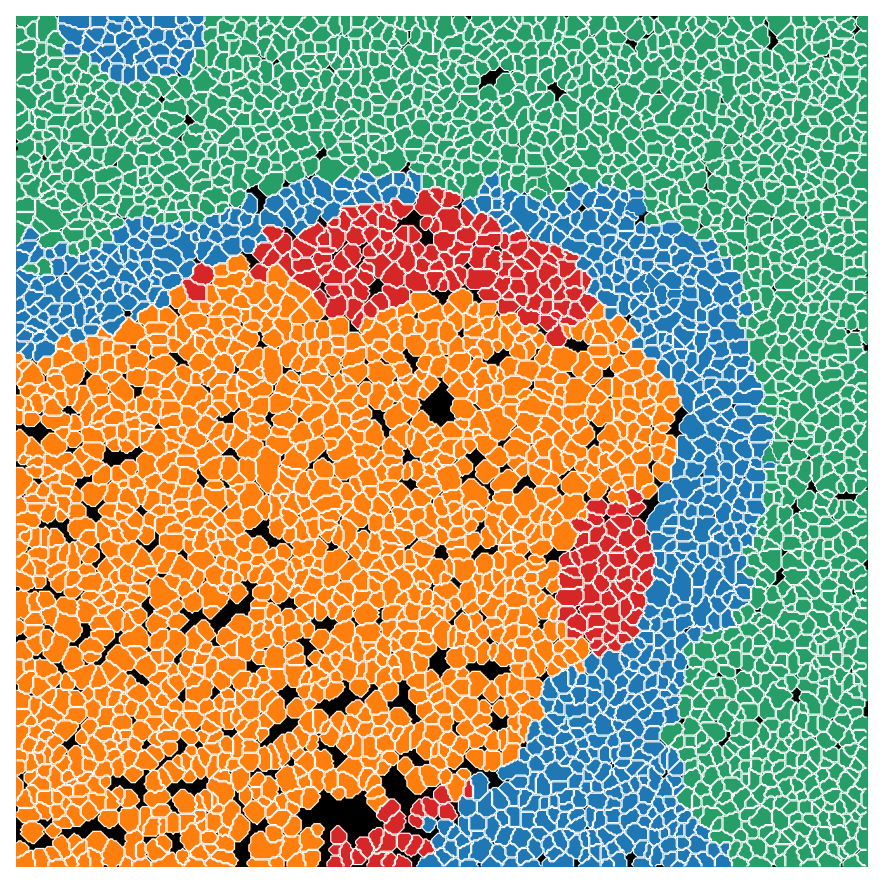

  0%|          | 0/4 [00:00<?, ?it/s]

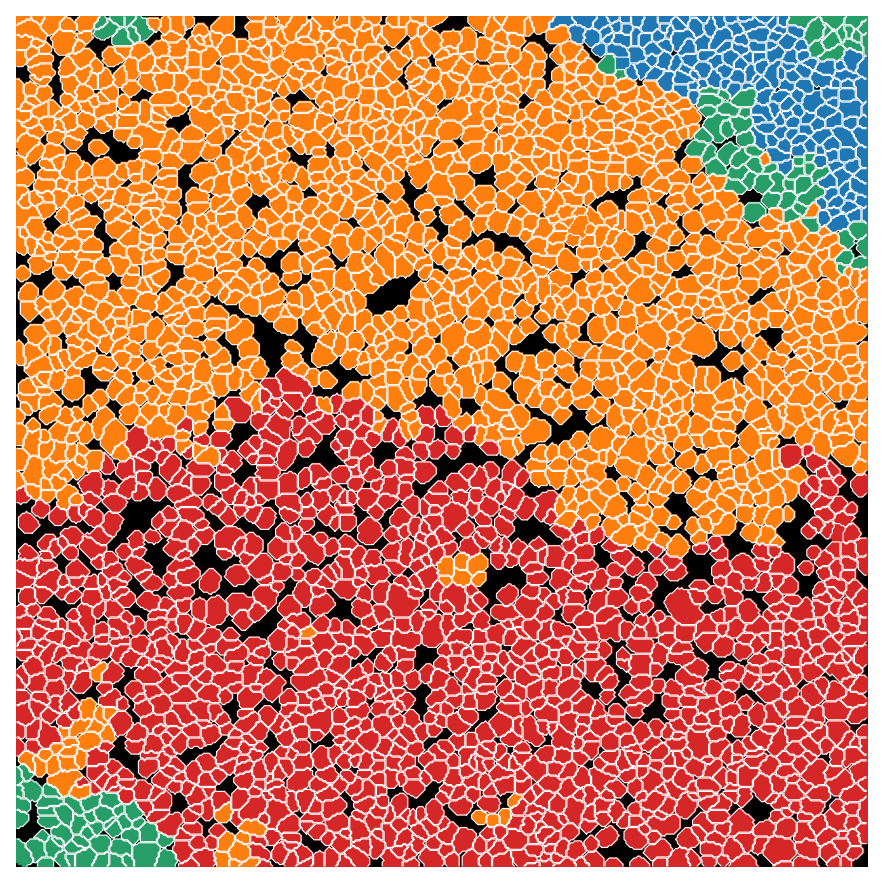

  0%|          | 0/4 [00:00<?, ?it/s]

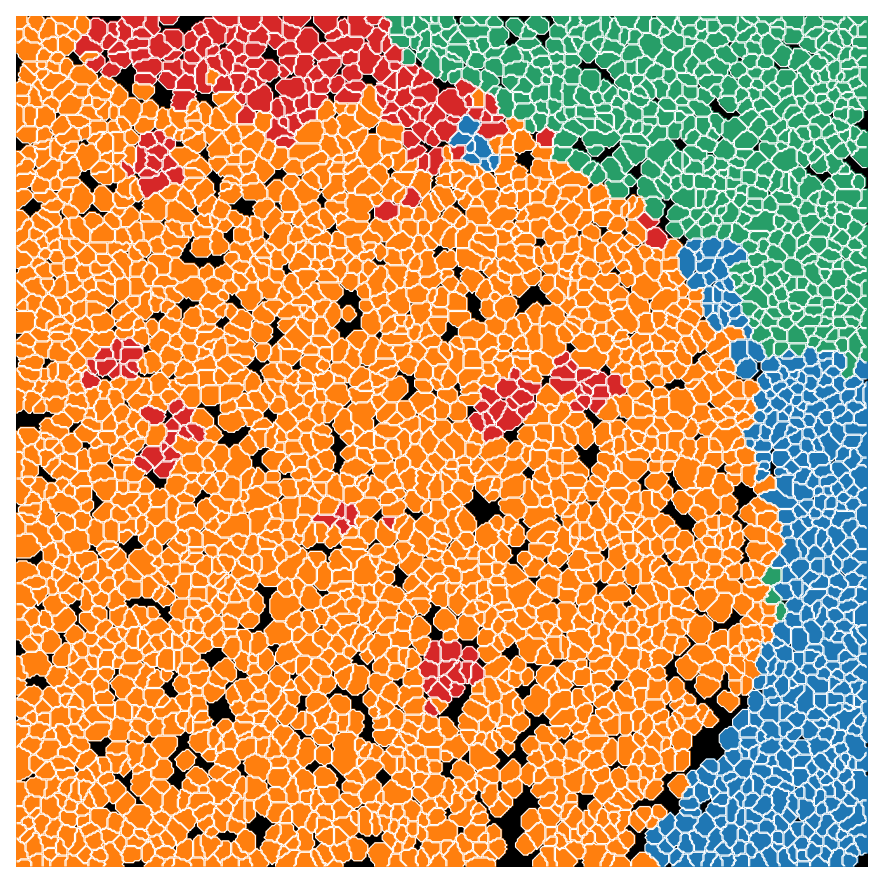

  0%|          | 0/4 [00:00<?, ?it/s]

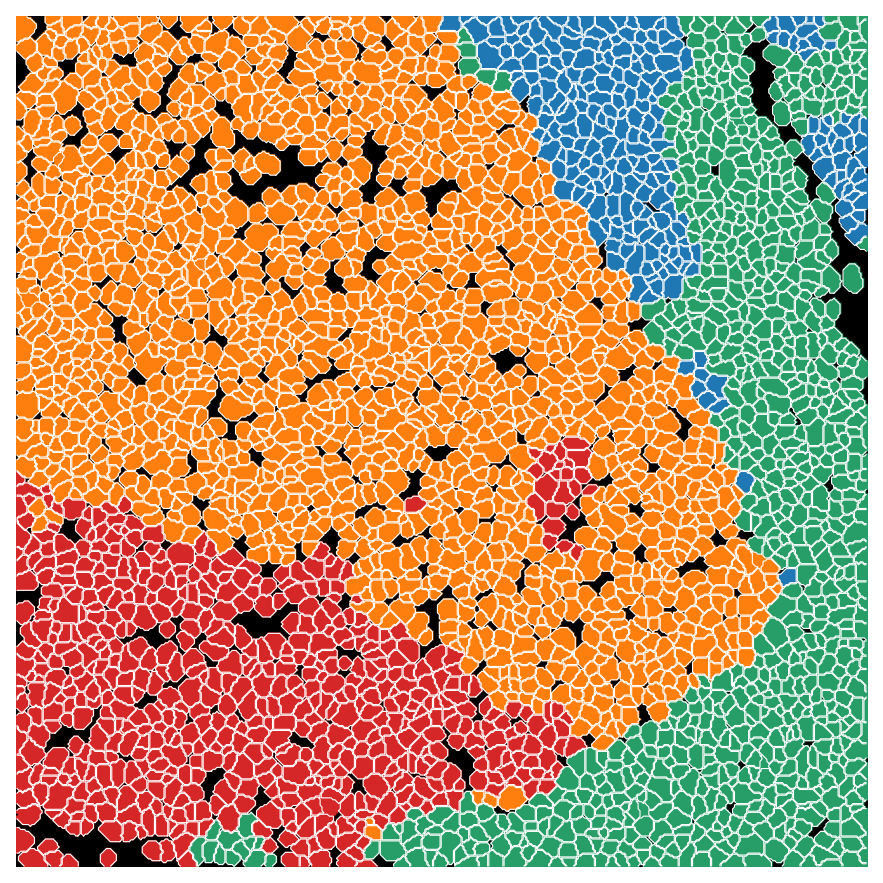

  0%|          | 0/4 [00:00<?, ?it/s]

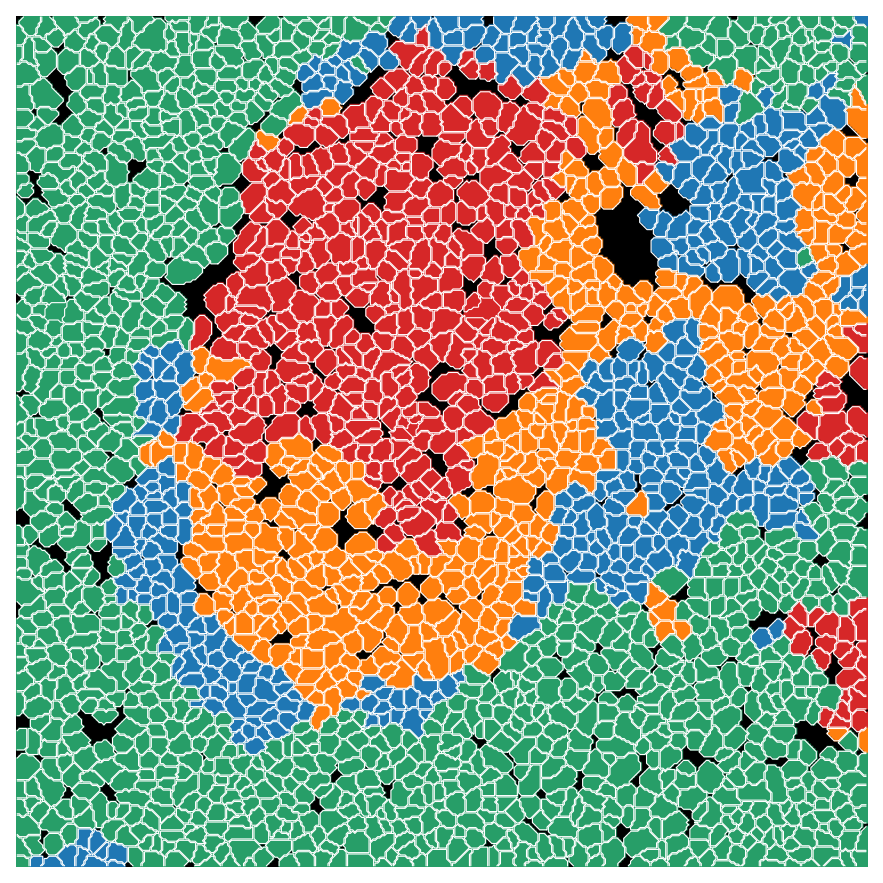

  0%|          | 0/4 [00:00<?, ?it/s]

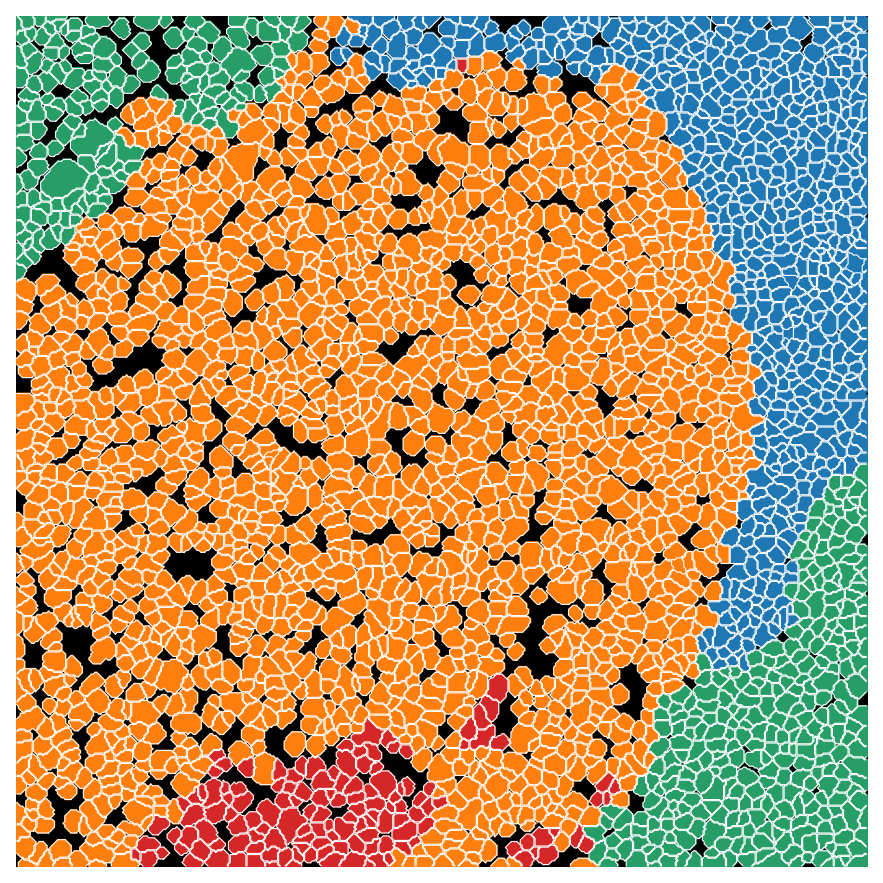

In [64]:
for dataset in adata_CN.obs['Core'].unique():
    adata_fov = adata_CN[adata_CN.obs['Core'] == dataset]
    try:
        mask = masks["_".join([experiment, dataset])]
        contours = get_contour(mask)
    except:
        print(dataset)
        continue
     # Get label2cell dict
    
    label2cell = {}
    for i, l in enumerate(labels):
        cell_id = adata_fov[adata_fov.obs.CN == l].obs.Cell.to_list()
        label2cell[i] = cell_id

    img = create_clustered_cell(mask, label2cell, colors_rgb)

    fig, ax = plt.subplots(figsize=(7, 7))
    ax.imshow(img)
    for j, contour in enumerate(contours):
        ax.plot(contour[:, 1], contour[:, 0], linewidth=0.5, color="white")
    ax.axis("off")
    fig.savefig(f'Region_{dataset}.png', dpi=100, bbox_inches='tight', transparent=True, pad_inches=0)
    plt.show()


In [65]:
type_dict = {0: 'Follicle Zone',
            1: 'GC Light Zone',
            2: 'Outside Follicle', 
            3: 'GC Dark Zone',
            }

In [66]:
adata_CN.obs['Region'] = (
    adata_CN.obs['CN']
    .map(type_dict)
    .astype("category")
)
adata_CN.uns['Region_colors'] = adata_CN.uns['CN_colors']

In [67]:

colors = adata_CN.uns["Region_colors"]
labels = adata_CN.obs.Region.cat.categories.tolist()

colors_rgb = []
for color in colors:
    colors_rgb.append(matplotlib.colors.hex2color(color))
colors_rgb = np.array(colors_rgb) * 255
colors_rgb = colors_rgb.astype(np.uint8)

colors_rgb_dict = {k:v for k,v in zip(labels, colors_rgb)}

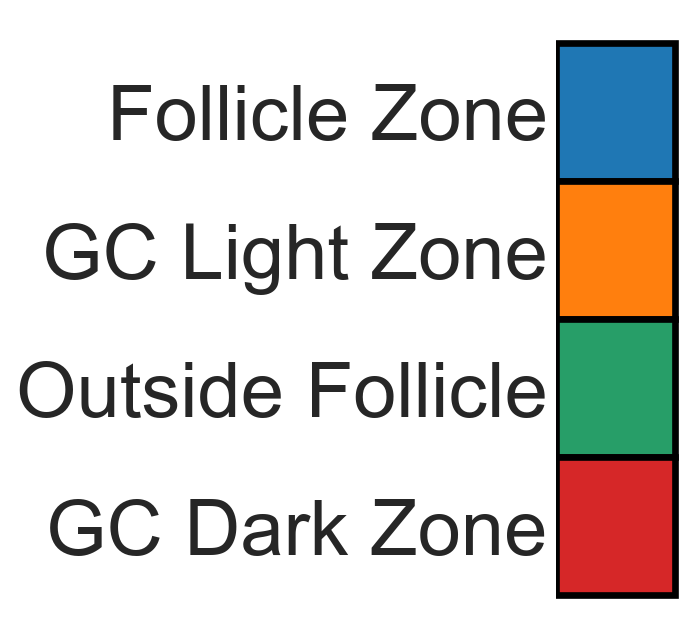

In [68]:
c=colors_rgb
# legend
fig, ax = plt.subplots(figsize=(1,5))
ax.barh(y=range(len(colors_rgb_dict.values())), 
        color=c/255,
        width=1, 
        height=1,
        edgecolor='k',
        linewidth=3,
       )
_ = plt.yticks(range(len(colors_rgb_dict.values())), labels, rotation=0, size=35)
_ = plt.xticks([])
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.tick_params(axis=u'both', which=u'both',length=0)
# ax.yaxis.tick_right()
ax.invert_yaxis()
ax.grid(False)


In [389]:
type_dict = {0: 'Outside GC',
            1: 'GC',
            2: 'Outside GC', 
            3: 'GC',
            }

In [390]:
adata_CN.obs['Region_GC'] = (
    adata_CN.obs['CN']
    .map(type_dict)
    .astype("category")
)
adata_CN.uns['Region_GC_colors'] = adata_CN.uns['CN_colors'][:len(np.unique(adata_CN.obs['Region_GC']))]

In [391]:
# Add to original data
adata_IMC.obs['Region_GC'] = adata_CN.obs['Region_GC']
adata_IMC.uns['Region_GC_colors'] = adata_CN.uns['Region_GC_colors']

# Save data

In [392]:
# path = data_dir / "adata" / f"{experiment}_GC_1017.h5ad"
# adata_IMC.write(path)
